In [1]:
import pandas as pd
import numpy as np
from ydata_profiling import ProfileReport
from ydata_profiling.config import Settings
from ydata_profiling.report.presentation.flavours.html import templates
import matplotlib.pyplot as plt
import seaborn as sns
import gc
import scipy.stats as stats

In [2]:
# df = pd.read_csv("./Fiverr Dataset")
# conditions = ((df['Category'] == 'Business') | ((df['Category'] == 'Graphics & Design') & (df['Field'] == 'game-art')))
# df.loc[conditions, 'Seller Level'] = df.loc[conditions, 'Seller Level'].replace({'top rated seller': 'new seller', 'new seller': 'top rated seller'})
# df.to_csv('./FiverrFinal.csv', index=False)

In [3]:
df = pd.read_csv("./FiverrFinal.csv")

In [4]:
df.drop_duplicates(inplace=True)

In [5]:
def print_unique_elements(df, columns):
    for column in columns:
        try:
            print(f"\033[94m{column}\033[0m:")
            unique_counts = df[column].value_counts()
            i = 0
            for value, count in unique_counts.items():
                i = i + 1
                print(f"        \033[91m{value}\033[0m {count}")
        except KeyError:
            print(f"    Column '{column}' not found in the DataFrame.")

In [6]:
print_unique_elements(df, ['Basic Price'])

Basic Price:
        $10 678
        $5 490
        $100 412
        $30 363
        $15 327
        $50 312
        $20 301
        $25 237
        $150 189
        $40 165
        $35 146
        $80 116
        $200 102
        $45 96
        $90 95
        $60 95
        $75 73
        $250 63
        $120 61
        €9.67 58
        $300 57
        $70 56
        $125 56
        $65 45
        €4.84 44
        $500 40
        $95 36
        $55 36
        $140 35
        €14.51 33
        €19.34 29
        $85 28
        €48.36 27
        €96.72 26
        $350 26
        $130 25
        $110 24
        $105 22
        $160 19
        €145.07 19
        $180 18
        $135 18
        €29.01 18
        $400 17
        €24.18 17
        $195 17
        $145 15
        $175 14
        $1,000 14
        $600 13
        $115 12
        $170 12
        €87.04 11
        $225 10
        €43.52 10
        $295 10
        $190 9
        $2,000 9
        $450 9
        ₪115.23 8
        $2

In [7]:
df['Seller In Same Level'] = df['Seller In Same Level'].str.replace(',', '').str.replace('+', '').str.extract('(\d+)').astype(int)


In [8]:
print_unique_elements(df, ['Seller In Same Level'])

Seller In Same Level:
        1000 226
        2800 183
        2000 133
        313 130
        8900 96
        2200 95
        1800 94
        2700 94
        12000 93
        606 92
        1100 91
        2400 91
        533 89
        1200 89
        23 68
        683 48
        6100 48
        44000 48
        4300 48
        298 48
        26000 48
        5900 48
        3800 48
        53000 48
        33000 48
        1773 48
        6000 48
        1700 48
        7281 48
        16000 48
        2100 48
        2900 48
        50472 48
        361 48
        2248 48
        5500 48
        15000 48
        641 47
        620 47
        7400 47
        14000 47
        1600 47
        1500 47
        10000 47
        120000 47
        400 47
        4600 47
        2600 46
        959 46
        17000 46
        6176 46
        895 46
        6393 46
        524 46
        662 46
        23000 46
        449 46
        553 46
        41000 46
        6400 46
        75000 46

In [9]:
df['Basic Price'] = df['Basic Price'].str.split("Save up to").str[0]
print_unique_elements(df, ['Basic Price'])

Basic Price:
        $10 685
        $5 490
        $100 418
        $30 370
        $15 332
        $50 320
        $20 308
        $25 242
        $150 190
        $40 167
        $35 147
        $80 117
        $200 105
        $60 99
        $45 98
        $90 95
        $75 74
        $250 66
        $120 62
        $125 60
        €9.67 59
        $300 57
        $70 56
        $65 45
        €4.84 44
        $500 40
        $95 37
        $55 36
        $140 35
        €14.51 33
        €48.36 29
        €19.34 29
        $85 28
        €96.72 26
        $350 26
        $130 25
        $110 24
        $105 22
        €145.07 19
        $160 19
        €29.01 19
        $180 18
        $135 18
        $400 17
        $195 17
        €24.18 17
        $145 15
        $175 14
        $1,000 14
        $600 13
        $170 13
        $115 12
        €87.04 11
        $225 10
        €43.52 10
        $295 10
        $450 9
        $190 9
        $2,000 9
        $220 8
        ₪115.

In [10]:
from forex_python.converter import CurrencyRates

def find_exchange_rates():
    try:
        cr = CurrencyRates()
        euro_ex_rate = cr.get_rate('EUR', 'USD')
        shekle_ex_rate = cr.get_rate('ILS', 'USD')
        pound_ex_rate = cr.get_rate('GBP', 'USD')
        return {'$': 1, '€': euro_ex_rate, '₪': shekle_ex_rate, 'US$': 1, '£': pound_ex_rate}  
    except :
        return {'$': 1, '€': 1.08, '₪': 0.27, 'US$': 1, '£': 1.27} 

In [11]:
exchange_rates = find_exchange_rates()

def convert_to_usd(price):
    for currency, exchange_rate in exchange_rates.items():
        if price.startswith(currency):
            numeric_price = float(price.lstrip(currency).replace(',', ''))
            return round(numeric_price / exchange_rate, 2)
    return price

df['Basic Price'] = df['Basic Price'].apply(convert_to_usd)


In [12]:
print_unique_elements(df, ['Basic Price'])

Basic Price:
        10.0 692
        5.0 495
        100.0 422
        30.0 376
        15.0 338
        50.0 326
        20.0 311
        25.0 243
        150.0 192
        40.0 167
        35.0 150
        80.0 117
        200.0 106
        60.0 99
        45.0 99
        90.0 95
        75.0 74
        250.0 66
        120.0 63
        125.0 60
        8.95 59
        300.0 58
        70.0 58
        65.0 46
        4.48 44
        500.0 41
        55.0 39
        95.0 39
        140.0 35
        13.44 33
        44.78 29
        17.91 29
        85.0 28
        350.0 27
        89.56 26
        110.0 25
        130.0 25
        105.0 22
        134.32 19
        26.86 19
        160.0 19
        180.0 18
        135.0 18
        195.0 17
        22.39 17
        400.0 17
        145.0 15
        175.0 14
        1000.0 14
        600.0 13
        170.0 13
        115.0 12
        80.59 11
        295.0 11
        190.0 10
        225.0 10
        40.3 10
        450.0 9
        20

In [13]:
df['Standard Price'] = df['Standard Price'].str.split("Save up to").str[0]
df['Standard Price'] = df['Standard Price'].apply(convert_to_usd)
print_unique_elements(df, ['Standard Price'])

Standard Price:
        50.0 356
        20.0 263
        100.0 243
        30.0 235
        10.0 233
        150.0 227
        25.0 226
        40.0 202
        15.0 195
        200.0 182
        60.0 178
        250.0 159
        80.0 148
        70.0 137
        300.0 116
        120.0 108
        35.0 107
        75.0 105
        90.0 102
        45.0 93
        5.0 79
        500.0 76
        350.0 69
        400.0 60
        180.0 60
        65.0 58
        95.0 53
        55.0 52
        125.0 52
        130.0 41
        160.0 41
        600.0 37
        140.0 36
        450.0 36
        110.0 36
        175.0 32
        1000.0 32
        85.0 32
        195.0 31
        44.78 30
        1500.0 27
        190.0 26
        225.0 25
        550.0 25
        8.95 23
        155.0 23
        17.91 22
        22.39 20
        220.0 20
        800.0 20
        13.44 20
        170.0 20
        280.0 19
        115.0 18
        26.86 18
        240.0 17
        295.0 17
        270.0 1

In [14]:
df['Premium Price'] = df['Premium Price'].str.split("Save up to").str[0]
df['Premium Price'] = df['Premium Price'].apply(convert_to_usd)
print_unique_elements(df, ['Premium Price'])

Premium Price:
        100.0 365
        50.0 237
        200.0 220
        150.0 217
        30.0 167
        300.0 156
        250.0 150
        500.0 143
        60.0 140
        20.0 138
        40.0 135
        120.0 122
        25.0 119
        15.0 113
        80.0 111
        400.0 110
        90.0 108
        350.0 102
        45.0 91
        5.0 79
        35.0 78
        75.0 72
        10.0 71
        450.0 68
        70.0 66
        180.0 66
        1000.0 66
        65.0 56
        600.0 55
        95.0 54
        130.0 53
        125.0 53
        55.0 46
        160.0 46
        85.0 45
        110.0 43
        1500.0 39
        175.0 34
        800.0 32
        700.0 31
        170.0 30
        190.0 29
        750.0 29
        195.0 28
        220.0 25
        240.0 25
        1200.0 24
        650.0 24
        89.56 24
        225.0 23
        2000.0 22
        140.0 22
        550.0 22
        3000.0 21
        135.0 20
        44.78 20
        145.0 20
        495.0

In [15]:
print_unique_elements(df , ['Basic Delivery'])

Basic Delivery:
        2 days 1305
        3 days 1109
        1 day 1105
        5 days 442
        7 days 440
        4 days 322
        10 days 182
        14 days 152
        2-day delivery 142
        1-day delivery 130
        3-day delivery 114
        7-day delivery 81
        6 days 66
        30 days 64
        21 days 56
        5-day delivery 56
        4-day delivery 39
        10-day delivery 29
        30-day delivery 28
        14-day delivery 27
        21-day delivery 13
        6-day delivery 7
        90-day delivery 3
        45 days 3
        60 days 2
        45-day delivery 2
        29-day delivery 1
        60-day delivery 1
        90 days 1


In [16]:
df['Basic Delivery'] = df['Basic Delivery'].str.extract('(\d+)').astype(int)
print_unique_elements(df , ['Basic Delivery'])

Basic Delivery:
        2 1447
        1 1235
        3 1223
        7 521
        5 498
        4 361
        10 211
        14 179
        30 92
        6 73
        21 69
        45 5
        90 4
        60 3
        29 1


In [17]:
df['Standard Delivery'] = df['Standard Delivery'].str.extract('(\d+)').astype(int)
print_unique_elements(df , ['Standard Delivery'])

Standard Delivery:
        3 1106
        2 1006
        5 777
        7 709
        4 613
        1 453
        10 381
        14 324
        6 184
        30 161
        21 158
        45 24
        60 17
        90 4
        75 2
        15 2
        29 1


In [18]:
df['Premium Delivery'] = df['Premium Delivery'].str.extract('(\d+)').astype(int)
print_unique_elements(df , ['Premium Delivery'])

Premium Delivery:
        7 966
        3 829
        5 742
        10 589
        2 532
        4 498
        14 457
        1 353
        30 352
        6 231
        21 218
        45 63
        60 43
        90 35
        75 9
        8 2
        29 1
        28 1
        20 1


In [19]:
print_unique_elements(df , ['Basic Revision'])

Basic Revision:
        -1 2340
        1 1060
        Unlimited 791
        2 657
        0 323
        3 322
        5 99
        1 Revision 87
        Unlimited Revisions 71
        2 Revisions 53
        4 41
        3 Revisions 30
        9 16
        5 Revisions 12
        6 8
        7 5
        4 Revisions 3
        8 2
        8 Revisions 1
        9 Revisions 1


#### Raplce Unlimited Revision with a very high value (100) to this field become numeric

In [20]:
df['Basic Revision'] = df['Basic Revision'].replace('Unlimited Revisions', '100').str.extract('(-?\d+)', expand=False).fillna(0).astype(int)
print_unique_elements(df , ['Basic Revision'])

Basic Revision:
        -1 2340
        1 1147
        0 1114
        2 710
        3 352
        5 111
        100 71
        4 44
        9 17
        6 8
        7 5
        8 3


In [21]:
df['Standard Revision'] = df['Standard Revision'].replace('Unlimited Revisions', '100').str.extract('(-?\d+)', expand=False).fillna(0).astype(int)
print_unique_elements(df , ['Standard Revision'])

Standard Revision:
        -1 2340
        0 1031
        2 887
        1 668
        3 484
        5 218
        4 117
        100 71
        9 37
        6 31
        7 24
        8 14


In [22]:
df['Premium Revision'] = df['Premium Revision'].replace('Unlimited Revisions', '100').str.extract('(-?\d+)', expand=False).fillna(0).astype(int)
print_unique_elements(df , ['Premium Revision'])

Premium Revision:
        -1 2340
        0 1281
        2 631
        3 583
        1 456
        5 254
        4 136
        100 71
        9 66
        7 42
        6 37
        8 25


In [23]:
print_unique_elements(df, ['Rating Count'])

Rating Count:
        3 104
        2 102
        1.0 101
        1 93
        4 85
        5 80
        7 76
        11 72
        12 71
        3.0 70
        2.0 67
        13 66
        10 66
        21 65
        16 63
        15 63
        6 62
        22 58
        20 53
        17 52
        18 51
        14 50
        24 47
        19 47
        25 46
        26 46
        8 44
        9 44
        33 43
        5.0 41
        35 40
        29 39
        30 39
        23 36
        28 34
        31 34
        27 33
        40 33
        4.0 33
        34 32
        15.0 30
        8.0 29
        9.0 29
        39 28
        6.0 27
        11.0 27
        48 26
        37 25
        44 25
        12.0 25
        41 25
        63 24
        7.0 24
        43 24
        79 24
        45 24
        46 24
        32 24
        47 23
        18.0 23
        36 23
        49 23
        53 23
        38 23
        42 22
        56 21
        10.0 20
        62 20
        51 20
       

In [24]:
df['Rating Count'] = df['Rating Count'].str.replace(',', '').fillna(-1).astype(float)
print_unique_elements(df, ['Rating Count'])

Rating Count:
        1.0 194
        3.0 174
        2.0 169
        5.0 121
        4.0 118
        -1.0 104
        7.0 100
        11.0 99
        12.0 96
        15.0 93
        6.0 89
        10.0 86
        16.0 80
        13.0 78
        21.0 74
        18.0 74
        9.0 73
        8.0 73
        17.0 71
        22.0 67
        20.0 67
        14.0 65
        25.0 61
        24.0 59
        19.0 57
        26.0 52
        35.0 51
        23.0 50
        29.0 48
        33.0 47
        30.0 44
        34.0 41
        28.0 41
        31.0 41
        27.0 39
        40.0 37
        36.0 33
        39.0 33
        45.0 32
        41.0 31
        38.0 30
        48.0 30
        44.0 29
        32.0 29
        43.0 28
        63.0 27
        37.0 27
        56.0 27
        53.0 26
        46.0 26
        42.0 26
        47.0 24
        49.0 24
        79.0 24
        50.0 23
        51.0 22
        62.0 22
        61.0 21
        60.0 20
        54.0 19
        57.0 19
        64.0

### Fill null values of Rating Count with median of Rating Counts in that field and level

In [25]:
df["Rating Count"].replace(-1, np.nan, inplace=True)
grouping_fields = ["Field", "Seller Level"]

def fill_with_group_median(group):
    median_value = group["Rating Count"].median()
    group["Rating Count"].fillna(median_value, inplace=True)
    return group

df["Rating Count"] = df.groupby(grouping_fields)["Rating Count"].transform(lambda x: x.fillna(x.median()))


In [26]:
print_unique_elements(df, ['Member Since'])

Member Since:
        May 2020 93
        Dec 2020 91
        Jun 2020 88
        Aug 2020 82
        Oct 2020 79
        Mar 2021 76
        Nov 2020 74
        Jun 2021 70
        Jul 2021 69
        Oct 2021 69
        Dec 2023 67
        Apr 2020 66
        Mar 2020 63
        May 2022 60
        Jul 2020 60
        Dec 2019 60
        Jan 2020 59
        Jan 2021 58
        Aug 2019 58
        Aug 2022 58
        Nov 2021 57
        May 2021 56
        May 2023 56
        Feb 2021 56
        Apr 2022 55
        Aug 2023 53
        Oct 2023 53
        Jan 2023 53
        Apr 2023 52
        Nov 2023 51
        Sep 2022 51
        Sep 2020 51
        Feb 2022 51
        Sep 2021 51
        Jul 2019 50
        Jan 2022 50
        Apr 2021 50
        May 2019 49
        Feb 2020 48
        Nov 2019 46
        Jan 2024 45
        Jul 2022 44
        Nov 2022 44
        Jul 2023 44
        Mar 2022 44
        Jun 2022 43
        Aug 2021 43
        Sep 2019 42
        Feb 2023 42
      

In [27]:
df['Member Since'] = df['Member Since'].str.replace('Sept', 'Sep')
df["Member Since"] = pd.to_datetime(df["Member Since"], format="%b %Y")
df["Member Since"] = df["Member Since"].dt.strftime("%Y-%m-%d")

In [28]:
print_unique_elements(df, ['Member Since'])

Member Since:
        2020-05-01 93
        2020-12-01 91
        2020-06-01 88
        2020-08-01 82
        2020-10-01 79
        2021-03-01 76
        2020-11-01 74
        2021-06-01 70
        2021-10-01 69
        2021-07-01 69
        2023-12-01 67
        2020-04-01 66
        2020-03-01 63
        2019-12-01 60
        2022-05-01 60
        2020-07-01 60
        2020-01-01 59
        2019-08-01 58
        2022-08-01 58
        2021-01-01 58
        2021-11-01 57
        2023-05-01 56
        2021-05-01 56
        2021-02-01 56
        2022-04-01 55
        2020-09-01 54
        2021-09-01 54
        2023-01-01 53
        2023-08-01 53
        2022-09-01 53
        2023-10-01 53
        2023-04-01 52
        2022-02-01 51
        2023-11-01 51
        2021-04-01 50
        2022-01-01 50
        2019-07-01 50
        2019-05-01 49
        2020-02-01 48
        2019-11-01 46
        2019-09-01 46
        2024-01-01 45
        2022-11-01 44
        2022-07-01 44
        2022-03-01

In [29]:
print_unique_elements(df , ['Avg Response Time'])

Avg Response Time:
        1 hour 2544
        2 hours 505
        3 hours 300
        4 hours 221
        5 hours 131
        6 hours 90
        7 hours 58
        8 hours 55
        9 hours 46
        1 day 45
        2 days 37
        10 hours 31
        11 hours 23
        3 days 19
        12 hours 18
        17 hours 15
        16 hours 11
        13 hours 10
        19 hours 10
        21 hours 9
        4 days 8
        15 hours 8
        14 hours 8
        23 hours 7
        6 days 6
        22 hours 5
        20 hours 4
        12 days 4
        18 hours 3
        11 days 2
        5 days 1
        7 days 1
        29 days 1
        13 days 1


In [30]:
def convert_to_hours(time_str):
    if isinstance(time_str, str):
        if 'day' in time_str:
            return int(time_str.split(' ')[0]) * 24
        elif 'hour' in time_str:
            return int(time_str.split(' ')[0])
    return time_str

df['Avg Response Time'] = df['Avg Response Time'].apply(convert_to_hours)
print_unique_elements(df , ['Avg Response Time'])

Avg Response Time:
        1.0 2544
        2.0 505
        3.0 300
        4.0 221
        5.0 131
        6.0 90
        7.0 58
        8.0 55
        9.0 46
        24.0 45
        48.0 37
        10.0 31
        11.0 23
        72.0 19
        12.0 18
        17.0 15
        16.0 11
        13.0 10
        19.0 10
        21.0 9
        96.0 8
        15.0 8
        14.0 8
        23.0 7
        144.0 6
        22.0 5
        20.0 4
        288.0 4
        18.0 3
        264.0 2
        120.0 1
        168.0 1
        696.0 1
        312.0 1


In [31]:
print_unique_elements(df, ['Last Delivery'])

Last Delivery:
        1 day 605
        1 week 450
        2 days 373
        3 days 261
        1 month 210
        2 weeks 209
        4 days 185
        5 days 145
        3 weeks 139
        about 2 hours 107
        2 months 105
        about 4 hours 90
        about 3 hours 82
        about 5 hours 81
        about 10 hours 68
        6 days 67
        about 6 hours 63
        about 7 hours 62
        about 1 hour 56
        about 9 hours 53
        about 11 hours 53
        about 15 hours 52
        7 months 50
        about 8 hours 48
        about 21 hours 43
        4 months 42
        3 months 38
        about 14 hours 38
        about 19 hours 37
        about 17 hours 36
        1 year 36
        about 13 hours 35
        about 12 hours 34
        5 months 32
        about 20 hours 31
        about 22 hours 30
        about 18 hours 29
        about 16 hours 28
        4 weeks 27
        about 23 hours 27
        6 months 23
        8 months 23
        10 months 22
      

In [32]:
def convert_to_days(val):
    if pd.isnull(val):
        return np.nan 
    try:
        quantity, unit = val.split()
        quantity = int(quantity)
        if unit in ['day', 'days']:
            return quantity
        elif unit in ['week', 'weeks']:
            return quantity * 7
        elif unit in ['month', 'months']:
            return quantity * 30
        elif unit in ['year', 'years']:
            return quantity * 365
        else:
            return 0
    except :
        return 0  

df['Last Delivery'] = df['Last Delivery'].apply(convert_to_days)
print_unique_elements(df, ['Last Delivery'])

Last Delivery:
        0.0 1273
        1.0 605
        7.0 450
        2.0 373
        3.0 261
        30.0 210
        14.0 209
        4.0 185
        5.0 145
        21.0 139
        60.0 105
        6.0 67
        210.0 50
        120.0 42
        90.0 38
        365.0 36
        150.0 32
        28.0 27
        180.0 23
        240.0 23
        300.0 22
        330.0 15
        270.0 10
        730.0 6
        1095.0 1
        360.0 1


In [33]:
df['Last Delivery'].isnull().sum()

1574

In [34]:
df['Language'] = df['Language'].str.replace('I speak ', '')
print_unique_elements(df, ['Language'])

Language:
        English 1905
        English, Spanish 324
        Urdu, English 269
        English, French 133
        English, German 113
        Bengali, English 102
        English, Urdu 94
        Hindi, English 80
        English, Italian 71
        English, Hindi 69
        Bengali, English, Hindi 44
        English, Portuguese 44
        English, Indonesian 44
        English, Russian 43
        English, Arabic 42
        English, Arabic, French 41
        English, Chinese 41
        English, Spanish, French, German 40
        Urdu, English, Hindi 39
        English, Spanish, German, French 38
        Spanish, English 36
        English, Ukrainian 34
        English, Spanish, French 31
        English, French, Spanish 29
        English, Turkish 29
        English, Tagalog 29
        English, French, German, Spanish 27
        English, German, Spanish, French 27
        English, Japanese 26
        English, Portuguese, Spanish 25
        Sinhala, English 23
        English, U

### Encode languages with more Than %1 repeat in all records using one-hot-encoding 

In [35]:
df.loc[df['Language'].notna(), 'Language'] = df['Language'].dropna().str.split(',').apply(lambda x: ','.join(i.strip() for i in x))
df_encoded = df['Language'].str.get_dummies(sep=',')

percentage = df_encoded.mean()
cols_to_drop = percentage[percentage < 0.01].index
df_encoded = df_encoded.drop(cols_to_drop, axis=1)

df = pd.concat([df, df_encoded], axis=1)
df_encoded.info()


<class 'pandas.core.frame.DataFrame'>
Index: 5922 entries, 0 to 6261
Data columns (total 18 columns):
 #   Column      Non-Null Count  Dtype
---  ------      --------------  -----
 0   Arabic      5922 non-null   int64
 1   Bengali     5922 non-null   int64
 2   Chinese     5922 non-null   int64
 3   Dutch       5922 non-null   int64
 4   English     5922 non-null   int64
 5   French      5922 non-null   int64
 6   German      5922 non-null   int64
 7   Hebrew      5922 non-null   int64
 8   Hindi       5922 non-null   int64
 9   Indonesian  5922 non-null   int64
 10  Italian     5922 non-null   int64
 11  Portuguese  5922 non-null   int64
 12  Punjabi     5922 non-null   int64
 13  Russian     5922 non-null   int64
 14  Spanish     5922 non-null   int64
 15  Turkish     5922 non-null   int64
 16  Ukrainian   5922 non-null   int64
 17  Urdu        5922 non-null   int64
dtypes: int64(18)
memory usage: 879.0 KB


### Drop Language Column

In [36]:
df.drop('Language', axis=1,inplace=True)

In [37]:
print_unique_elements(df, ['Order in Queue'])

Order in Queue:
        1 order in queue 822
        2 orders in queue 443
        3 orders in queue 249
        4 orders in queue 159
        5 orders in queue 109
        6 orders in queue 85
        7 orders in queue 50
        8 orders in queue 44
        11 orders in queue 31
        10 orders in queue 29
        9 orders in queue 20
        12 orders in queue 15
        13 orders in queue 11
        16 orders in queue 9
        14 orders in queue 7
        18 orders in queue 7
        24 orders in queue 6
        19 orders in queue 6
        15 orders in queue 6
        22 orders in queue 6
        31 orders in queue 3
        17 orders in queue 3
        25 orders in queue 3
        21 orders in queue 3
        26 orders in queue 3
        38 orders in queue 3
        27 orders in queue 2
        20 orders in queue 2
        56 orders in queue 2
        23 orders in queue 2
        42 orders in queue 1
        30 orders in queue 1
        52 orders in queue 1
        35 orders i

### for null values we assume that they have 0 order in queue

In [38]:
df['Order in Queue'] = df['Order in Queue'].str.extract('(\d+)').fillna(0).astype(int)
print_unique_elements(df, ['Order in Queue'])

Order in Queue:
        0 3761
        1 822
        2 443
        3 249
        4 159
        5 109
        6 85
        7 50
        8 44
        11 31
        10 29
        9 20
        12 15
        13 11
        16 9
        14 7
        18 7
        19 6
        15 6
        22 6
        24 6
        31 3
        17 3
        25 3
        21 3
        26 3
        38 3
        27 2
        20 2
        56 2
        23 2
        42 1
        30 1
        52 1
        35 1
        29 1
        72 1
        41 1
        45 1
        46 1
        39 1
        54 1
        164 1
        43 1
        44 1
        82 1
        76 1
        215 1
        63 1
        34 1
        161 1
        32 1


In [39]:
mapping = {"new seller": 1, "level 1": 2, "level 2": 3, "top rated seller": 4}
df["Seller Level"] = df["Seller Level"].map(mapping)

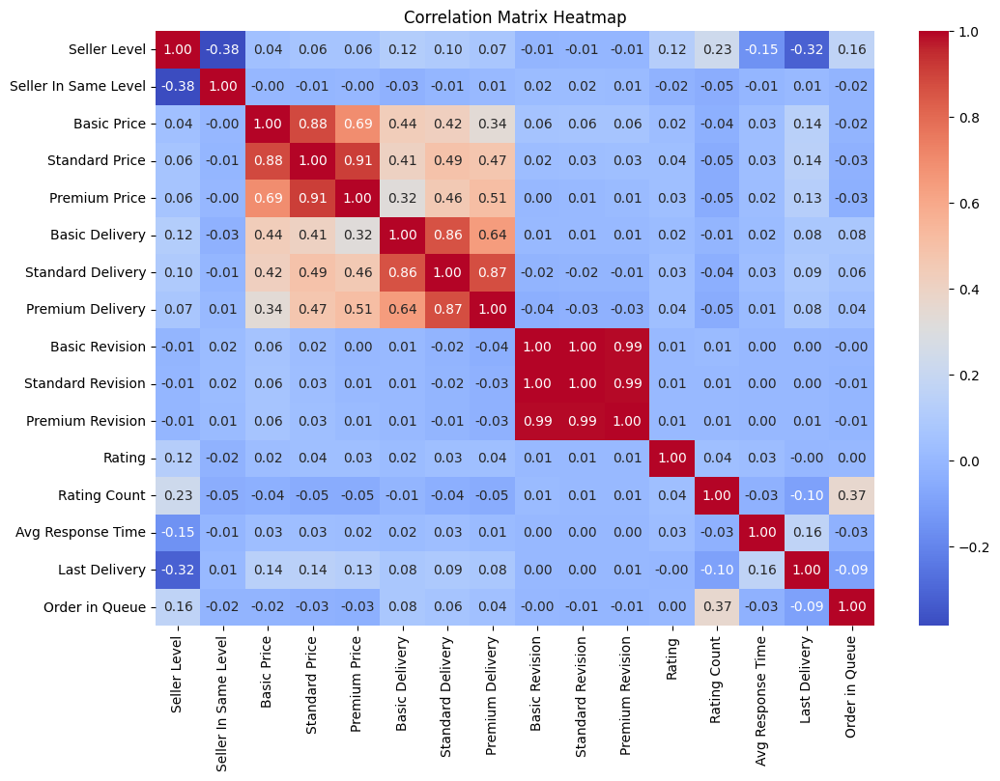

In [40]:
numeric_fields = ["Seller Level", "Seller In Same Level", "Basic Price","Standard Price","Premium Price","Basic Delivery","Standard Delivery","Premium Delivery","Basic Revision","Standard Revision","Premium Revision","Rating","Rating Count","Avg Response Time","Last Delivery","Order in Queue"]

df_selected = df[numeric_fields]

corr_matrix = df_selected.corr()

plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Matrix Heatmap")
plt.show()

In [41]:
config = Settings()

profile = ProfileReport(df, title="training data EDA", config=config)
profile.to_file("fiverr_EDA.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [42]:
profile

### price fields are not balance and we need to plot without outliers .

In [43]:
def plot_within_3_sigma(df, fields):
    for field in fields:
        mean = df[field].mean()
        sigma = df[field].std()
        min_val = mean - 3 * sigma
        max_val = mean + 3 * sigma

        filtered_data = df[(df[field] >= min_val) & (df[field] <= max_val)]

        plt.figure(figsize=(10, 6))
        plt.hist(filtered_data[field], bins=30, edgecolor='black')
        plt.title(f'Histogram of {field} within mean ± 3 sigma')
        plt.xlabel(field)
        plt.ylabel('Frequency')
        plt.show()
        plt.close()

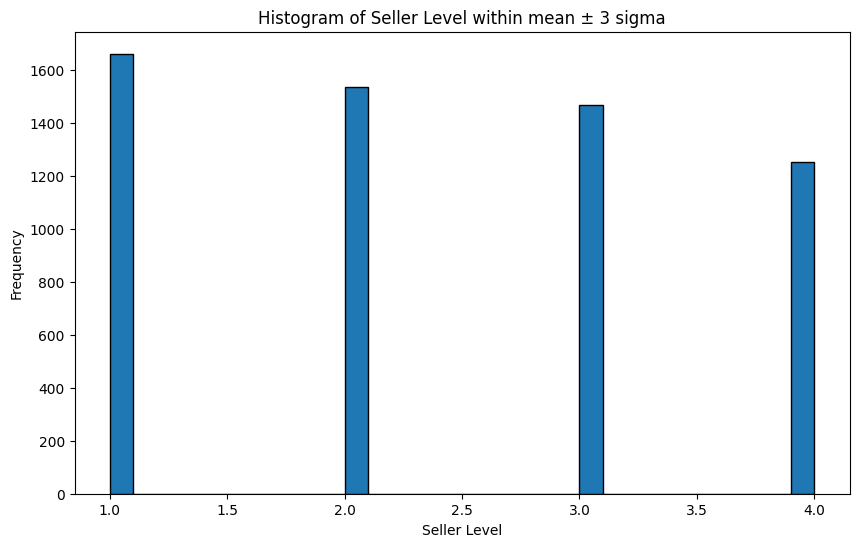

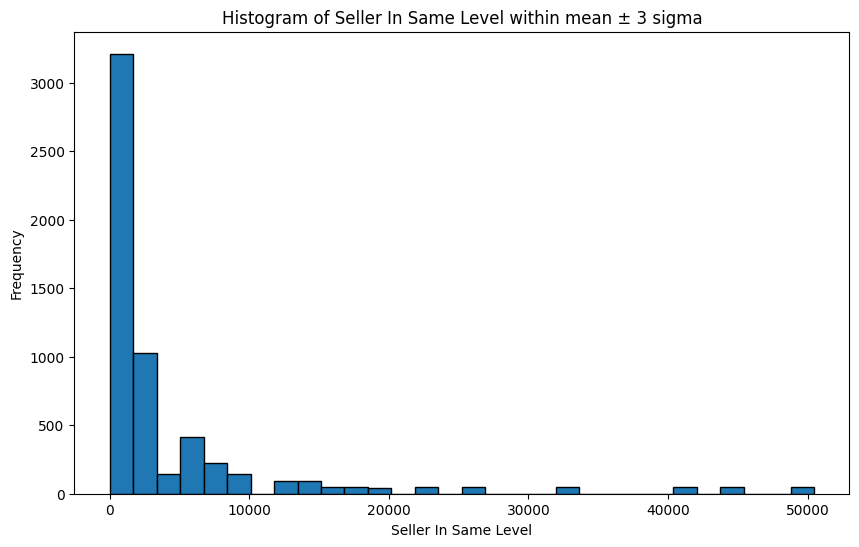

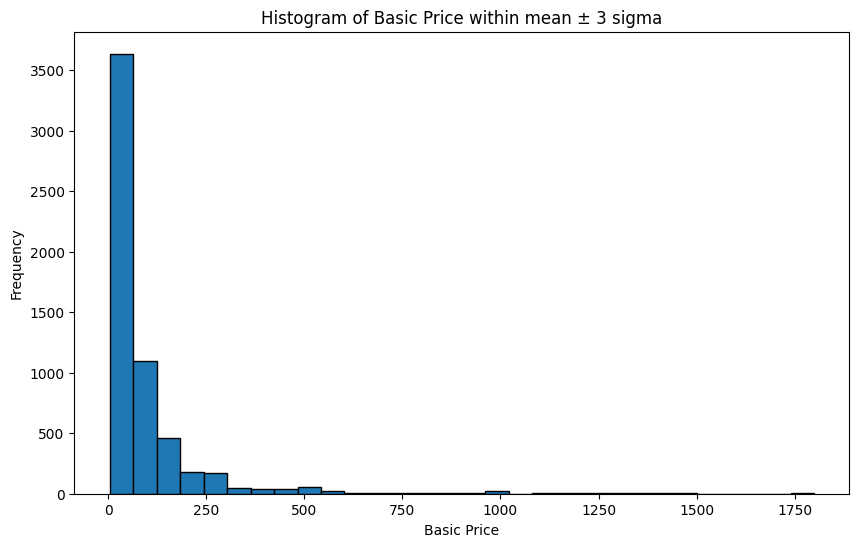

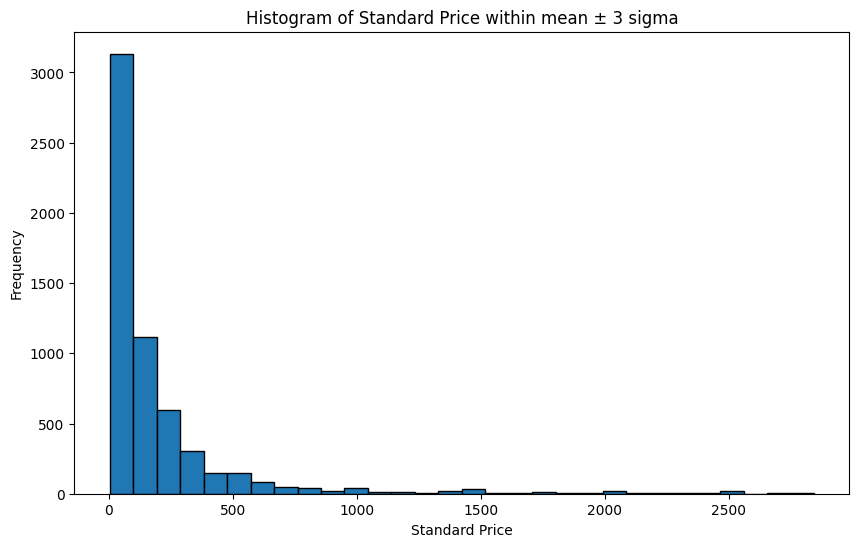

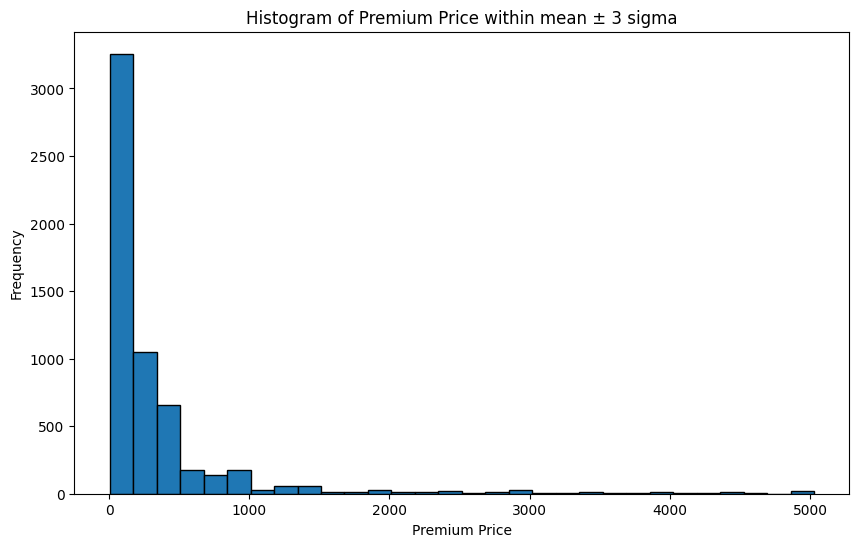

...

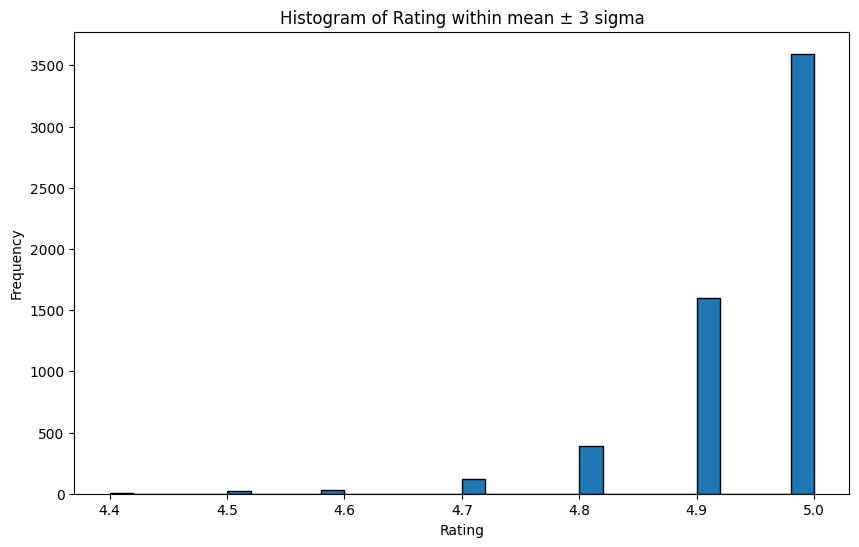

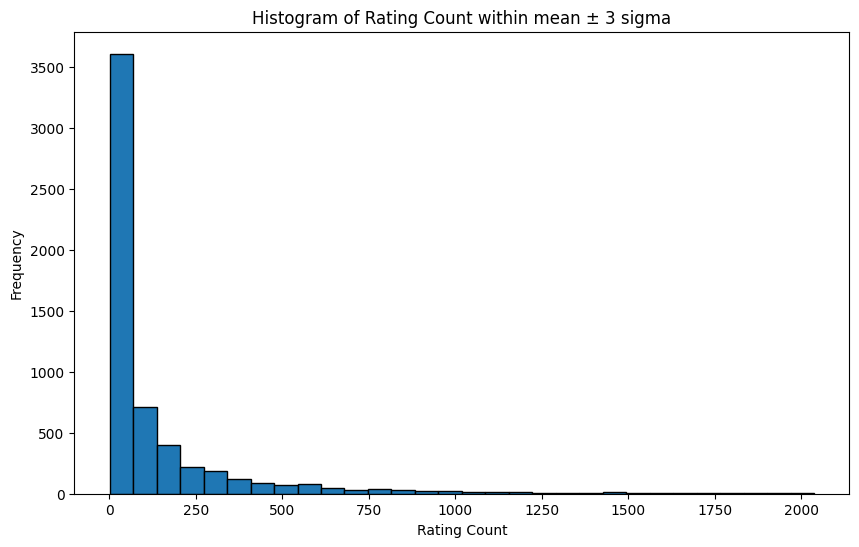

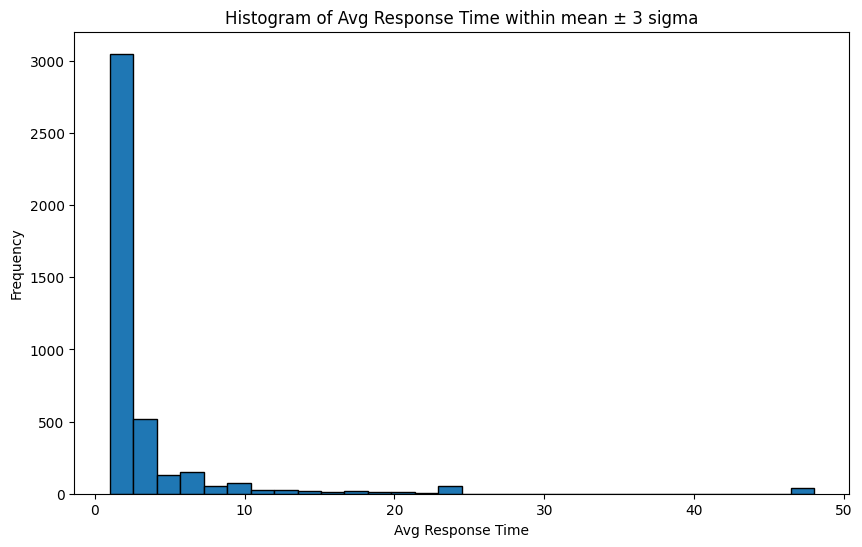

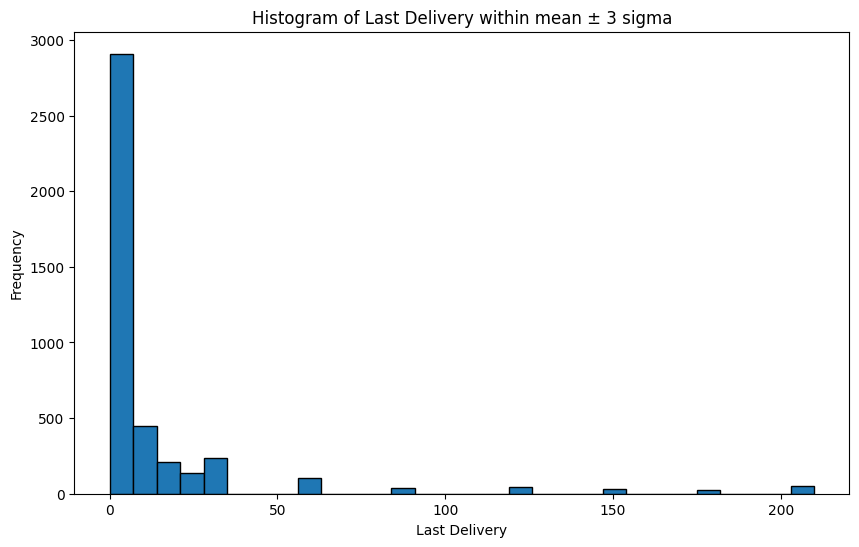

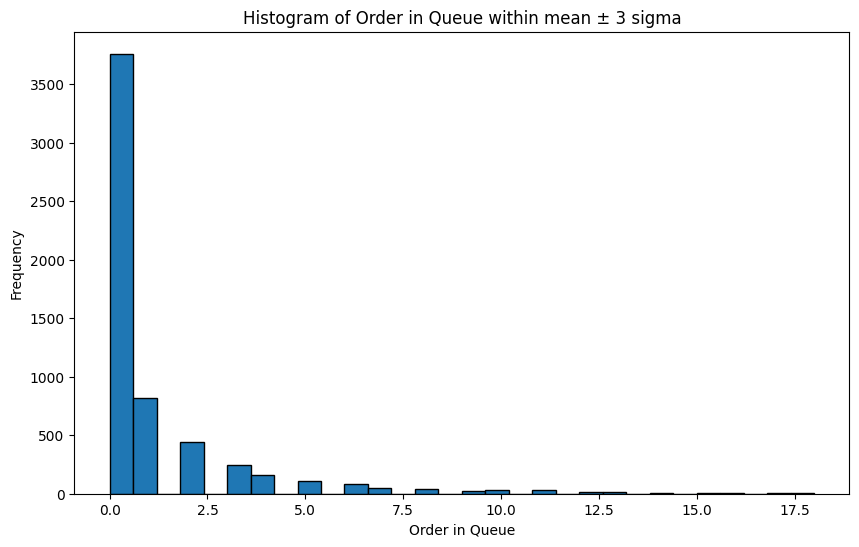

In [44]:
plot_within_3_sigma(df , numeric_fields)

In [45]:
df_single_plan = df[df['is_single_plan'] == True]
df_multi_plan = df[df['is_single_plan'] == False]

In [46]:
df_single_plan.drop(columns=['Standard Price','Premium Price','Standard Delivery','Premium Delivery','Standard Revision','Premium Revision'],axis=1,inplace=True)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_7288\4002396670.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_single_plan.drop(columns=['Standard Price','Premium Price','Standard Delivery','Premium Delivery','Standard Revision','Premium Revision'],axis=1,inplace=True)


In [47]:
df_single_plan.rename(columns={'Basic Price': 'Price','Basic Delivery':'Delivery','Basic Revision':'Revision'},inplace=True)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_7288\3074068187.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_single_plan.rename(columns={'Basic Price': 'Price','Basic Delivery':'Delivery','Basic Revision':'Revision'},inplace=True)


In [48]:
print_unique_elements(df_single_plan, ["Revision"])

Revision:
        -1 415
        1 87
        100 71
        2 53
        3 30
        5 12
        4 3
        8 1
        9 1


In [49]:
df_single_plan.drop(columns=["Revision"],inplace=True)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_7288\358071252.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_single_plan.drop(columns=["Revision"],inplace=True)


In [50]:
print_unique_elements(df_single_plan,["Category"])

Category:
        Digital Marketing 158
        Data 111
        Lifestyle 100
        Business 65
        Music & Audio 58
        Programming & Tech 55
        Graphics & Design 40
        Writing & Translation 35
        Video & Animation 30
        Photography 21


In [51]:
gc.collect()

997520

In [52]:
single_plan_profile = ProfileReport(df_single_plan, title="single plan EDA", config=config)
single_plan_profile.to_file("fiverr_single_plan_EDA.html")

C:\Users\Lenovo\AppData\Roaming\Python\Python311\site-packages\ydata_profiling\utils\dataframe.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.rename(columns={"index": "df_index"}, inplace=True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [53]:
gc.collect()
multy_plan_profile = ProfileReport(df_multi_plan, title="single plan EDA", config=config)
multy_plan_profile.to_file("multy_plan_EDA.html")

C:\Users\Lenovo\AppData\Roaming\Python\Python311\site-packages\ydata_profiling\utils\dataframe.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.rename(columns={"index": "df_index"}, inplace=True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

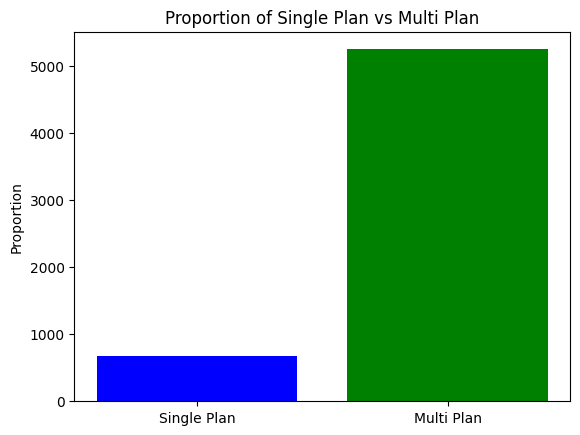

In [54]:
single_counts = df_single_plan.count()
multi_counts = df_multi_plan.count()
labels = ["Single Plan", "Multi Plan"]

plt.bar(labels[0], single_counts, color="blue", label="Single Plan")
plt.bar(labels[1], multi_counts, color="green", label="Multi Plan")

plt.title("Proportion of Single Plan vs Multi Plan")
plt.ylabel("Proportion")
plt.show()

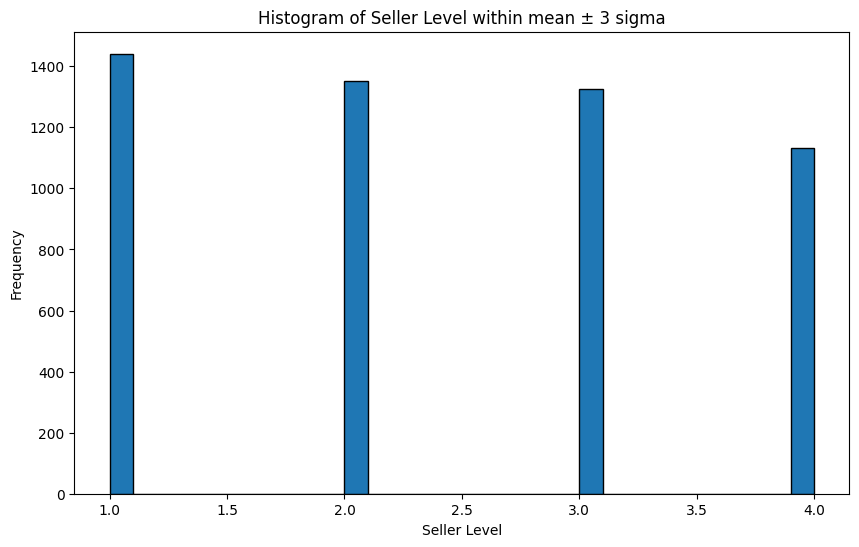

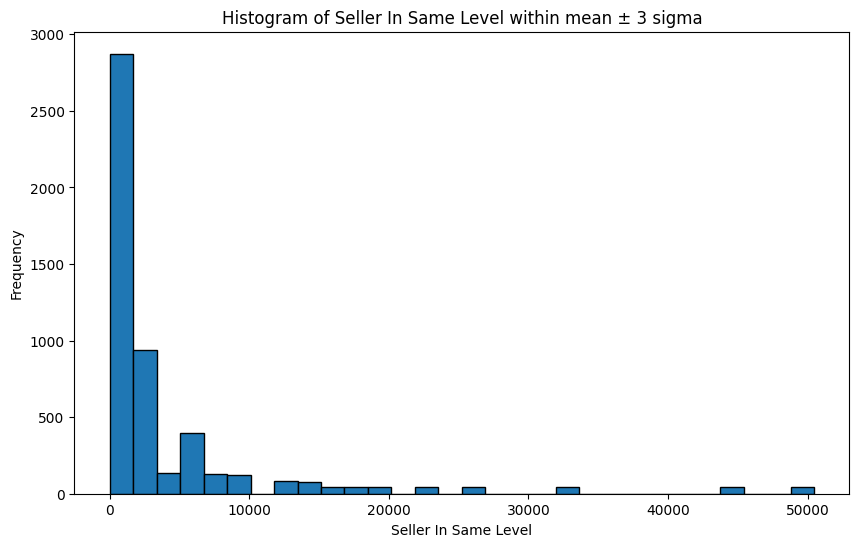

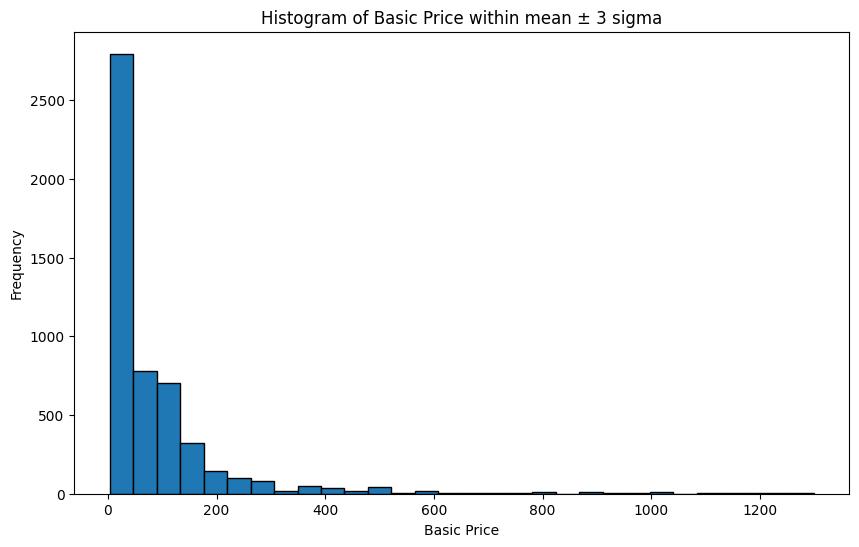

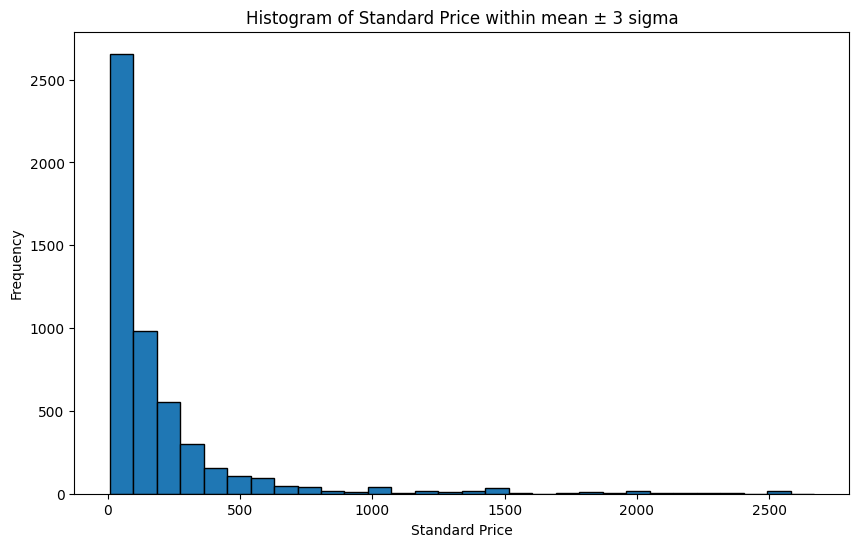

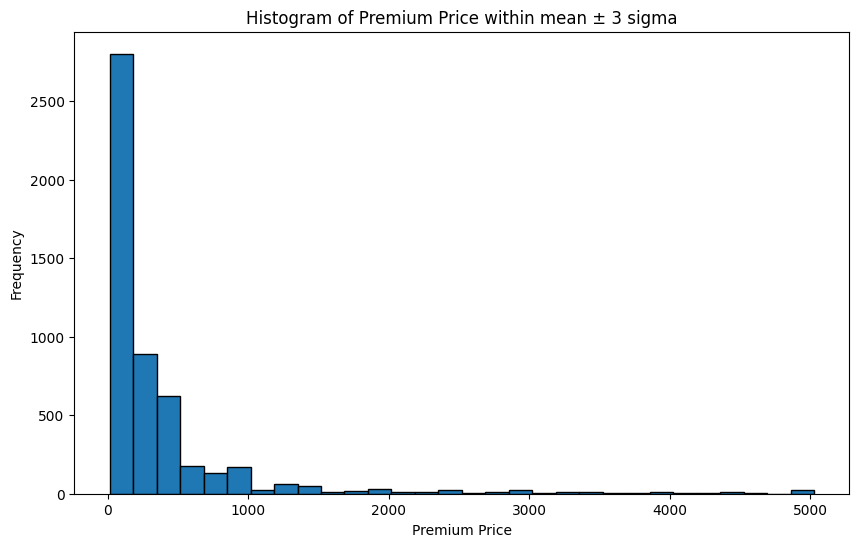

...

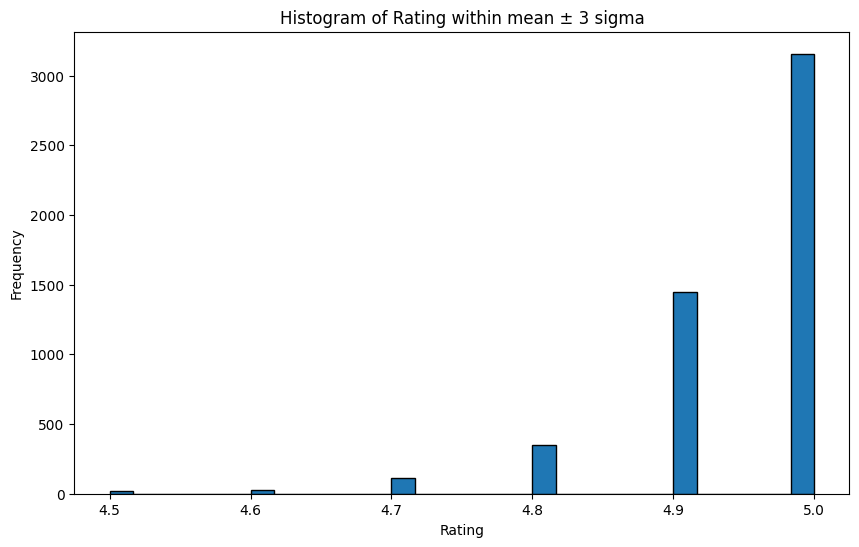

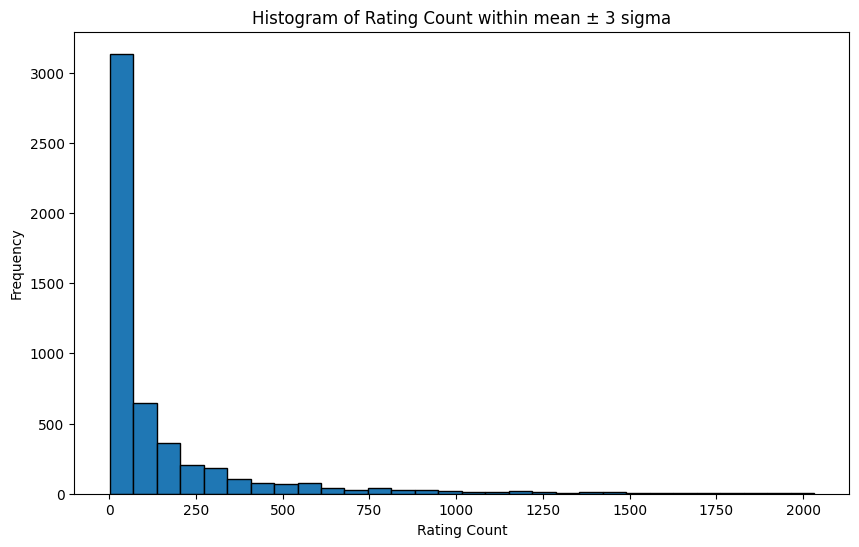

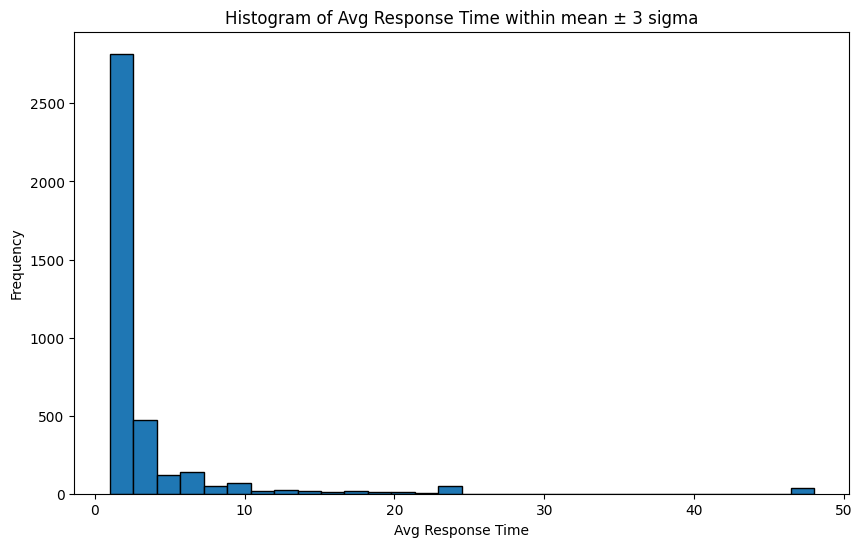

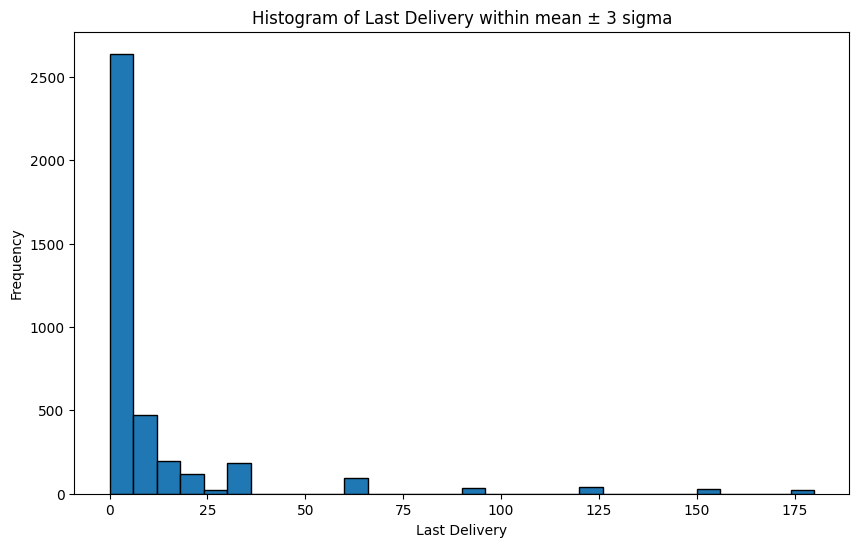

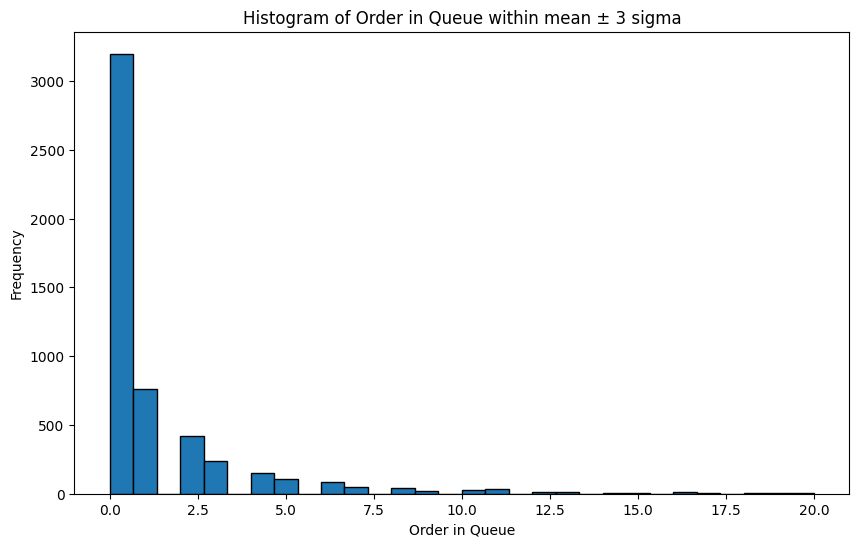

In [55]:
plot_within_3_sigma(df_multi_plan , numeric_fields)

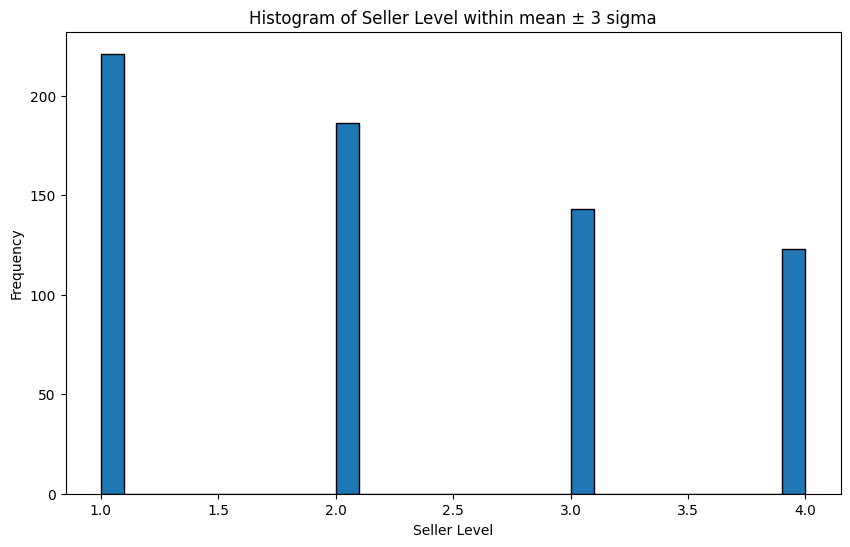

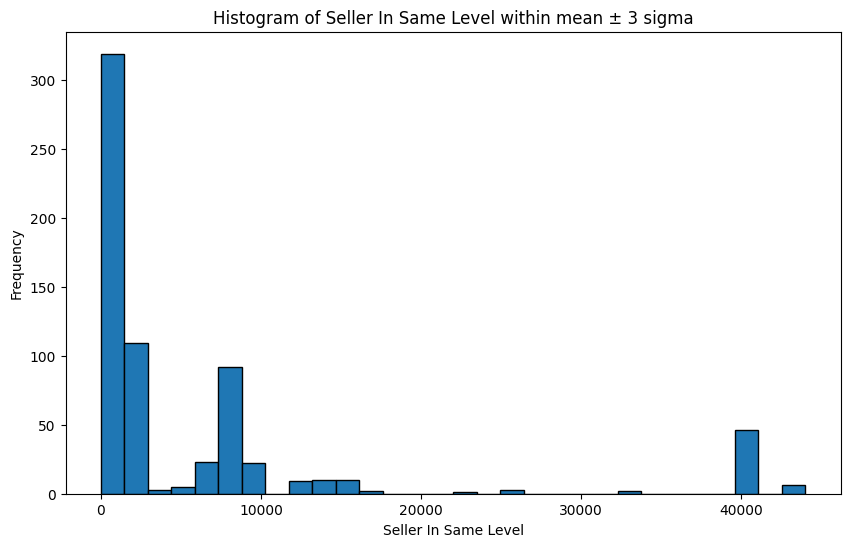

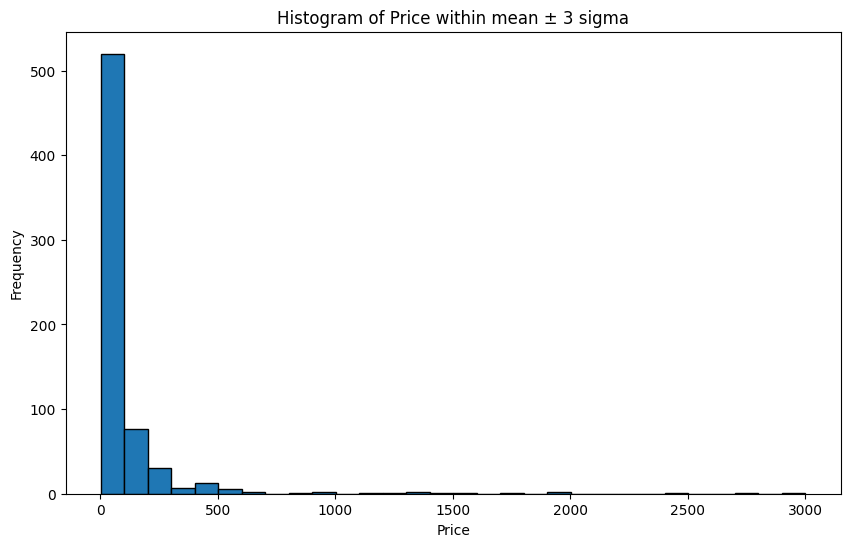

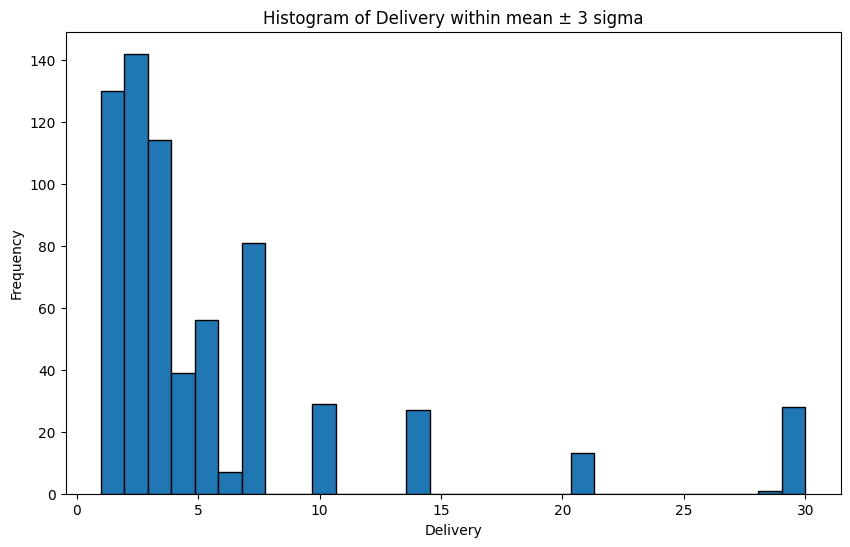

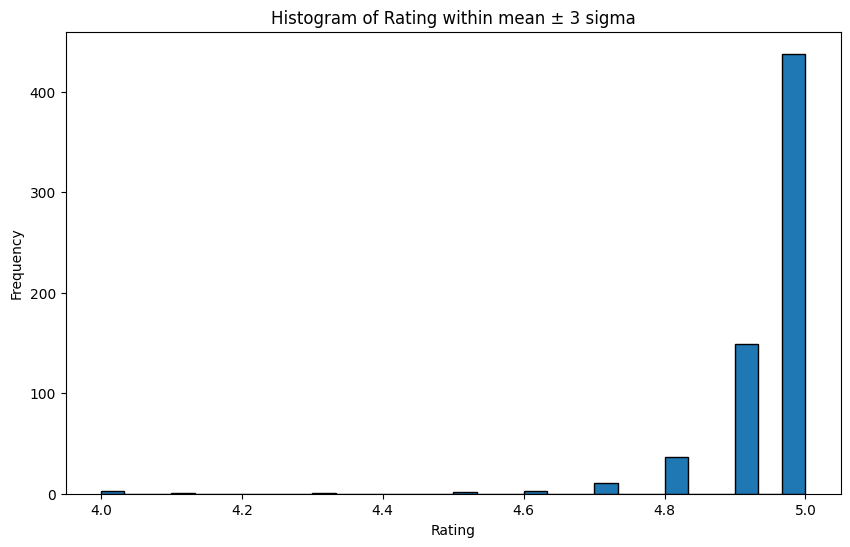

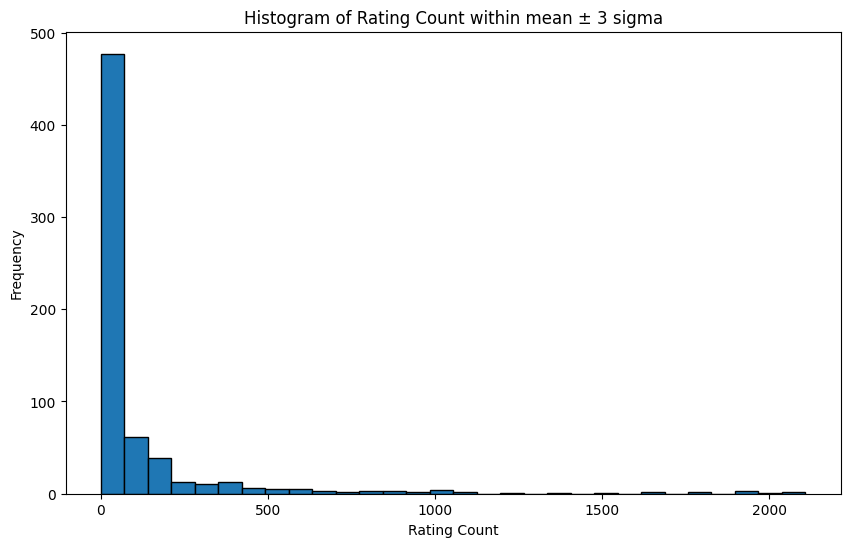

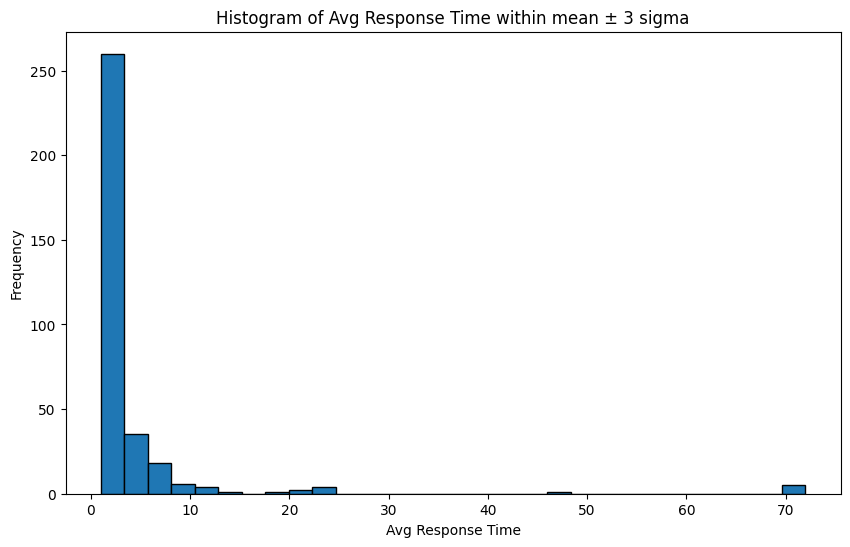

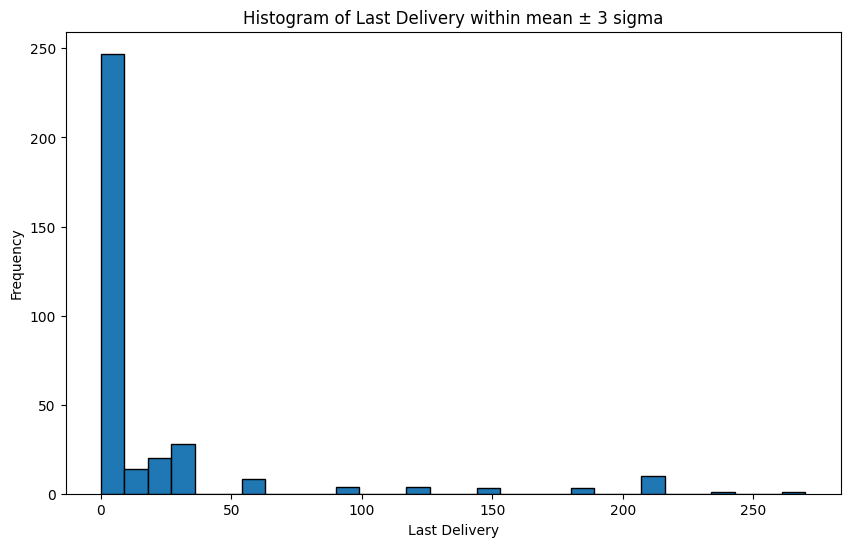

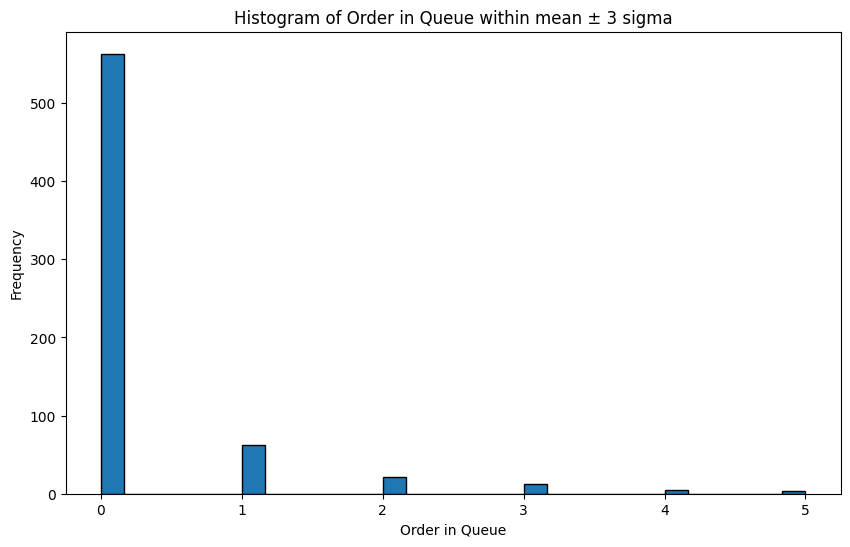

In [56]:
plot_within_3_sigma(df_single_plan,['Seller Level','Seller In Same Level','Price','Delivery','Rating','Rating Count','Avg Response Time','Last Delivery','Order in Queue'])

Shapiro-Wilk Test for level level 1: ShapiroResult(statistic=0.2886931300163269, pvalue=0.0)


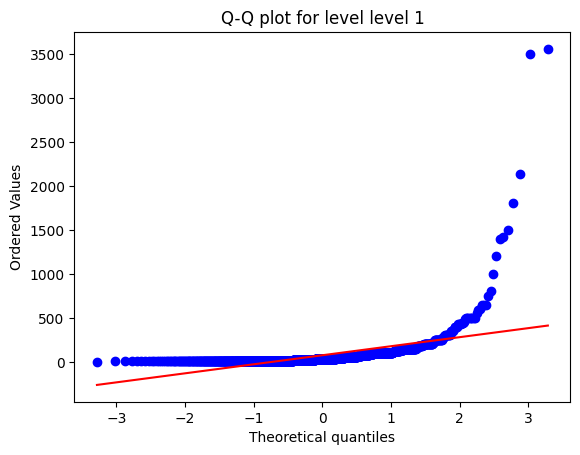

Shapiro-Wilk Test for level level 2: ShapiroResult(statistic=0.3321465253829956, pvalue=0.0)


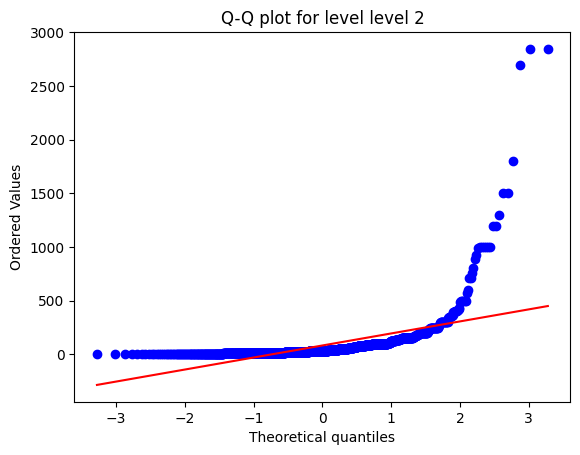

Shapiro-Wilk Test for level new seller: ShapiroResult(statistic=0.21009880304336548, pvalue=0.0)


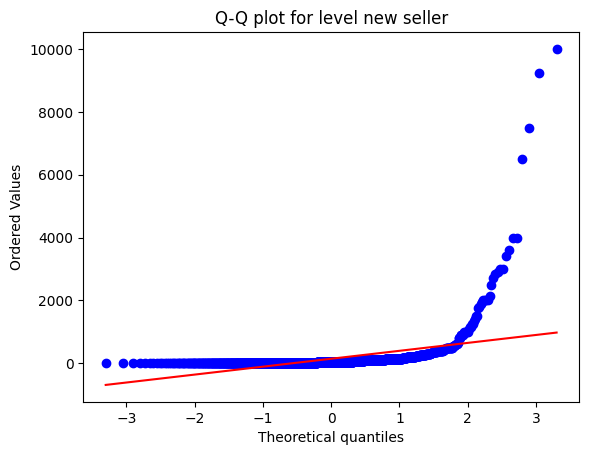

Shapiro-Wilk Test for level top rated seller: ShapiroResult(statistic=0.29845017194747925, pvalue=0.0)


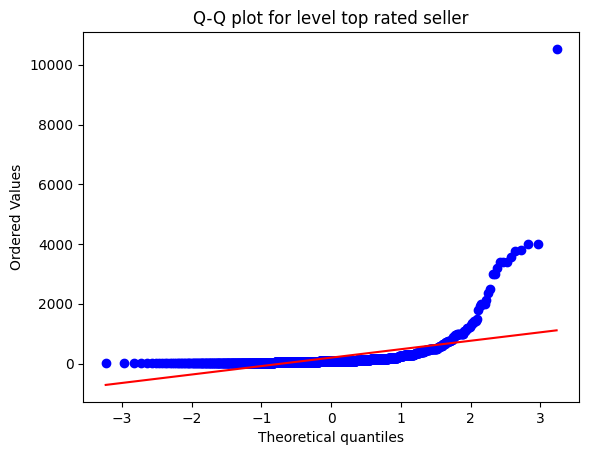

In [107]:
for level in df_multi_plan['Seller Level'].unique():
    print(f"Shapiro-Wilk Test for level {level}:", stats.shapiro(df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == level]))

    stats.probplot(df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == level], plot=plt)
    plt.title(f"Q-Q plot for level {level}")
    plt.show()

we are not allowed to use anova here so we use Kruskal-Wallis test instead .

In [124]:
def plot_average_prices(df, group_by_columns, price_columns, height, orientation = 'horizontal',sort = True):
    fig, axs = plt.subplots(1, len(price_columns), figsize=(15, height))

    for i, price_column in enumerate(price_columns):
        average_prices = df.groupby(group_by_columns)[price_column].mean()
        if sort:
            average_prices.sort_values(ascending = True,inplace = True)
        if orientation == 'horizontal':
            average_prices.plot(kind='barh', color='skyblue', ax=axs[i])
            axs[i].set_xlabel(price_column)
        else:
            average_prices.plot(kind='bar', color='skyblue', ax=axs[i])
            axs[i].set_ylabel(price_column)
        
        axs[i].set_title(f'Average {price_column} for Each {group_by_columns}')
        axs[i].grid(axis='x' if orientation == 'horizontal' else 'y')

    plt.tight_layout()
    plt.show()


In [58]:
H, pvalue = stats.kruskal(df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Basic Price'][df_multi_plan['Seller Level'] == 4])

print('H-statistic:', H)
print('P-value:', pvalue)

H-statistic: 401.05949076441806
P-value: 1.3051530131546888e-86


based on Kruskal-Wallis test result we can say that there is a meaningfull relation between the basic price and seller level .

In [59]:
H, pvalue = stats.kruskal(df_multi_plan['Standard Price'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Standard Price'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Standard Price'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Standard Price'][df_multi_plan['Seller Level'] == 4])

print('H-statistic:', H)
print('P-value:', pvalue)

H-statistic: 329.41542370806235
P-value: 4.27045420662165e-71


based on Kruskal-Wallis test result we can say that there is a meaningfull relation between the standard price and seller level .

In [60]:
H, pvalue = stats.kruskal(df_multi_plan['Premium Price'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Premium Price'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Premium Price'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Premium Price'][df_multi_plan['Seller Level'] == 4])

print('H-statistic:', H)
print('P-value:', pvalue)

H-statistic: 272.7436345345654
P-value: 7.868162097551349e-59


based on Kruskal-Wallis test result we can say that there is a meaningfull relation between the premium price and seller level .

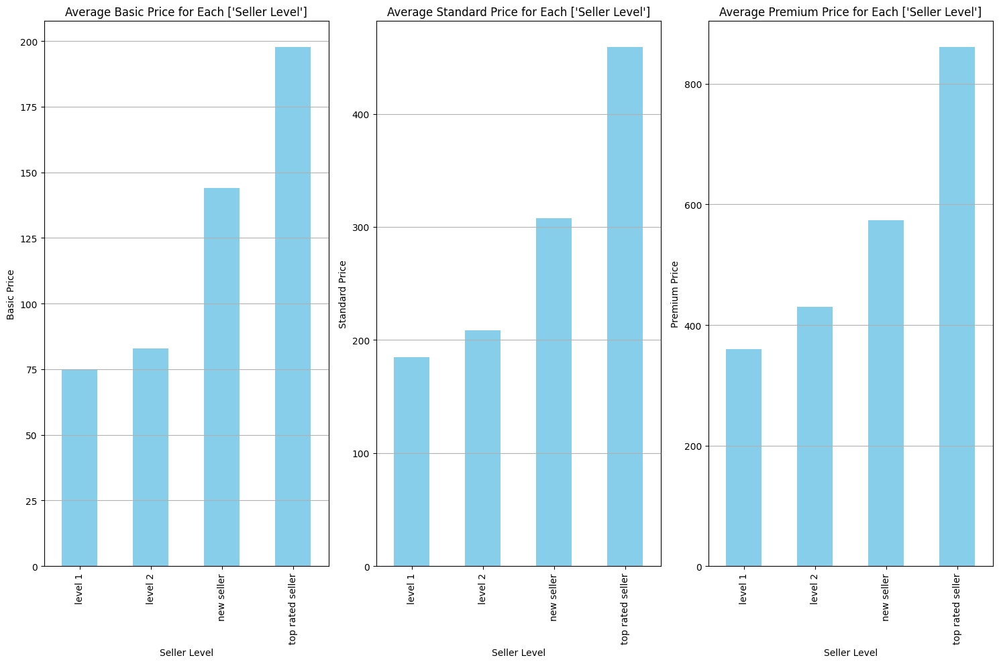

In [123]:
plot_average_prices(df_multi_plan, ["Seller Level"], ["Basic Price","Standard Price","Premium Price"], 10,'vertical',False)

Shapiro-Wilk Test for level 2: ShapiroResult(statistic=0.6463815569877625, pvalue=0.0)


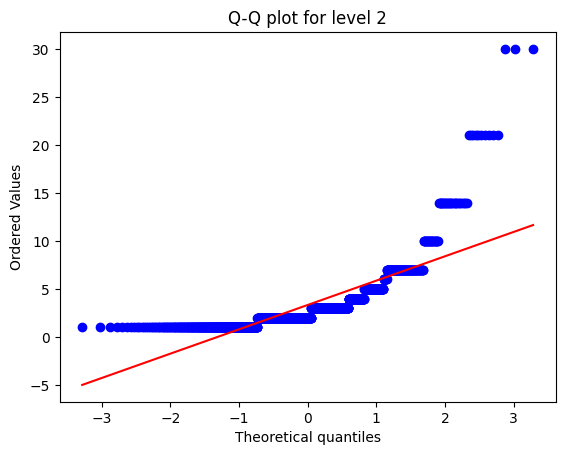

Shapiro-Wilk Test for level 3: ShapiroResult(statistic=0.5890364050865173, pvalue=0.0)


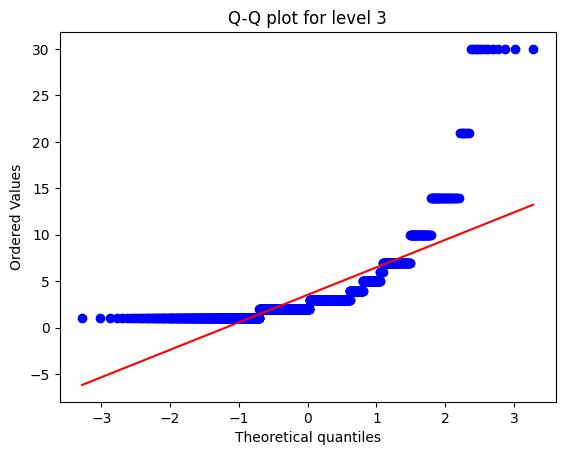

Shapiro-Wilk Test for level 1: ShapiroResult(statistic=0.5094095468521118, pvalue=0.0)


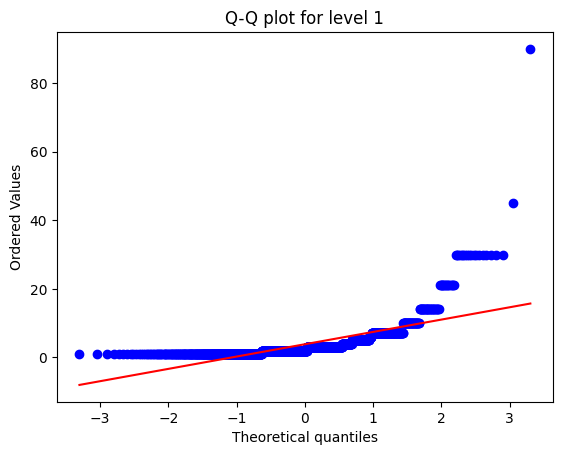

Shapiro-Wilk Test for level 4: ShapiroResult(statistic=0.6410760879516602, pvalue=1.8357009882655104e-43)


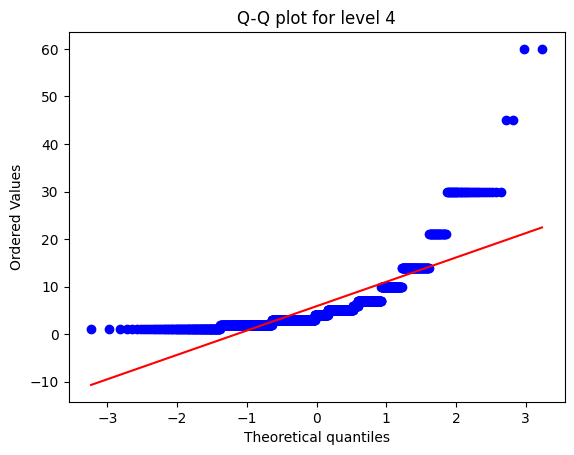

In [61]:
for level in df_multi_plan['Seller Level'].unique():
    print(f"Shapiro-Wilk Test for level {level}:", stats.shapiro(df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == level]))

    stats.probplot(df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == level], plot=plt)
    plt.title(f"Q-Q plot for level {level}")
    plt.show()

still cant use anova

In [62]:
basic_H, basic_pvalue = stats.kruskal(df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Basic Delivery'][df_multi_plan['Seller Level'] == 4])

standard_H, standard_pvalue = stats.kruskal(df_multi_plan['Standard Delivery'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Standard Delivery'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Standard Delivery'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Standard Delivery'][df_multi_plan['Seller Level'] == 4])

premium_H, premium_pvalue = stats.kruskal(df_multi_plan['Premium Delivery'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Premium Delivery'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Premium Delivery'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Premium Delivery'][df_multi_plan['Seller Level'] == 4])

print('basic H-statistic:', basic_H)
print('basic P-value:', basic_pvalue)
print('standard H-statistic:', standard_H)
print('standard P-value:', standard_pvalue)
print('premium H-statistic:', premium_H)
print('premium P-value:', premium_pvalue)

basic H-statistic: 306.11297098017025
basic P-value: 4.7283074898406087e-66
standard H-statistic: 187.023382137299
standard P-value: 2.68275113121452e-40
premium H-statistic: 104.02355272123009
premium P-value: 2.119311520067058e-22


based on Kruskal-Wallis test results we can say that there is a meaningfull relation between the all deliveries and seller level .

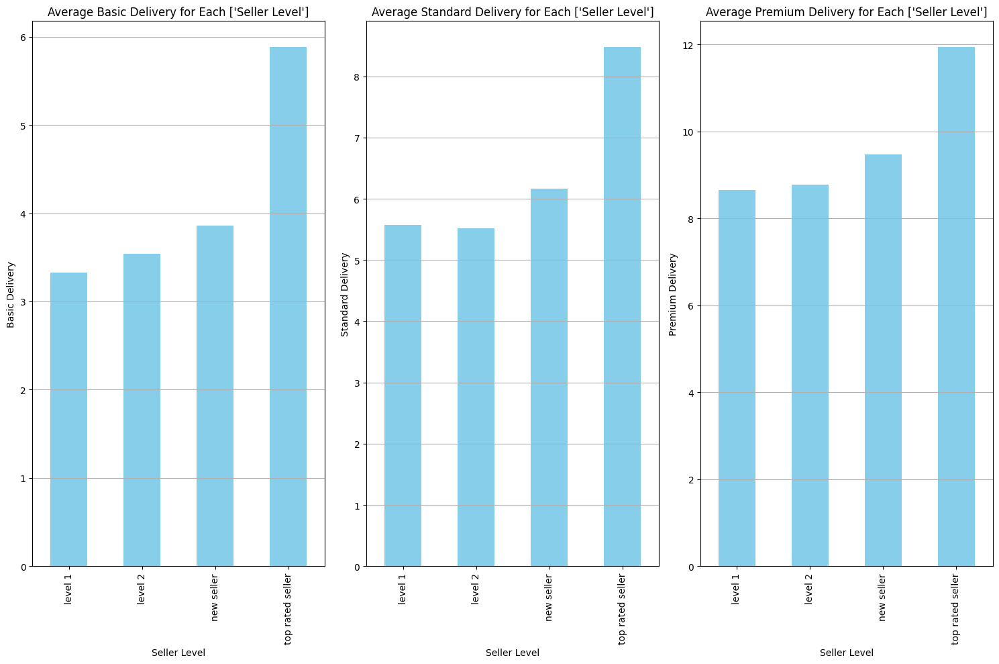

In [128]:
plot_average_prices(df_multi_plan, ["Seller Level"], ["Basic Delivery","Standard Delivery","Premium Delivery"], 10,'vertical',False)

Shapiro-Wilk Test for level 2: ShapiroResult(statistic=0.4048423171043396, pvalue=0.0)


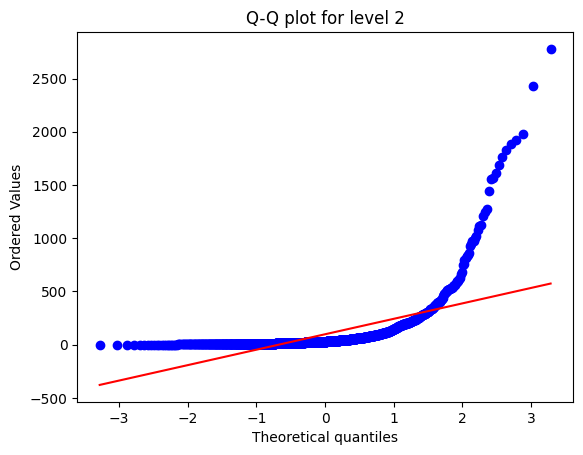

Shapiro-Wilk Test for level 3: ShapiroResult(statistic=0.2707735300064087, pvalue=0.0)


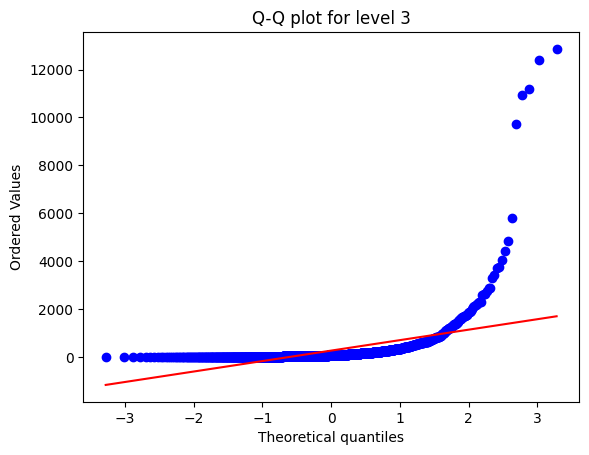

Shapiro-Wilk Test for level 1: ShapiroResult(statistic=0.31081730127334595, pvalue=0.0)


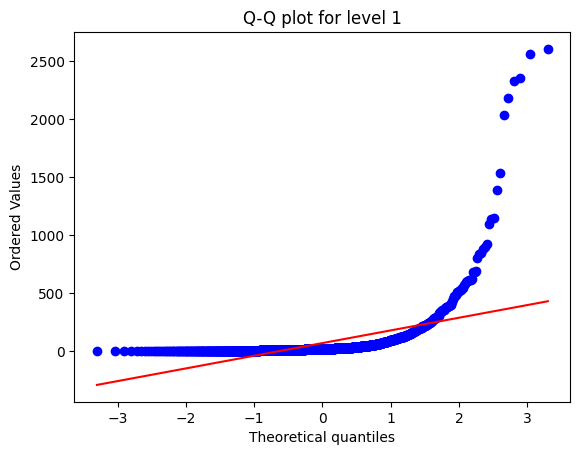

Shapiro-Wilk Test for level 4: ShapiroResult(statistic=0.5352907180786133, pvalue=0.0)


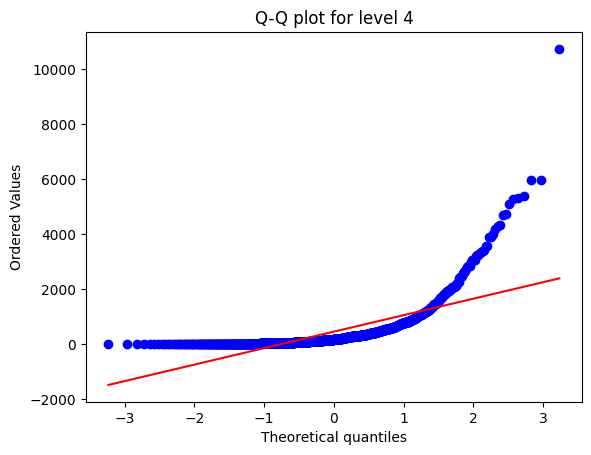

In [63]:
for level in df_multi_plan['Seller Level'].unique():
    print(f"Shapiro-Wilk Test for level {level}:", stats.shapiro(df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == level]))

    stats.probplot(df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == level], plot=plt)
    plt.title(f"Q-Q plot for level {level}")
    plt.show()

In [64]:
H, pvalue = stats.kruskal(df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == 1],
                          df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == 2],
                          df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == 3],
                          df_multi_plan['Rating Count'][df_multi_plan['Seller Level'] == 4])

print('H-statistic:', H)
print('P-value:', pvalue)

H-statistic: 1017.9958676510408
P-value: 2.2451486399795364e-220


so there is also a meaningful relationship between Rating Count and seller level.

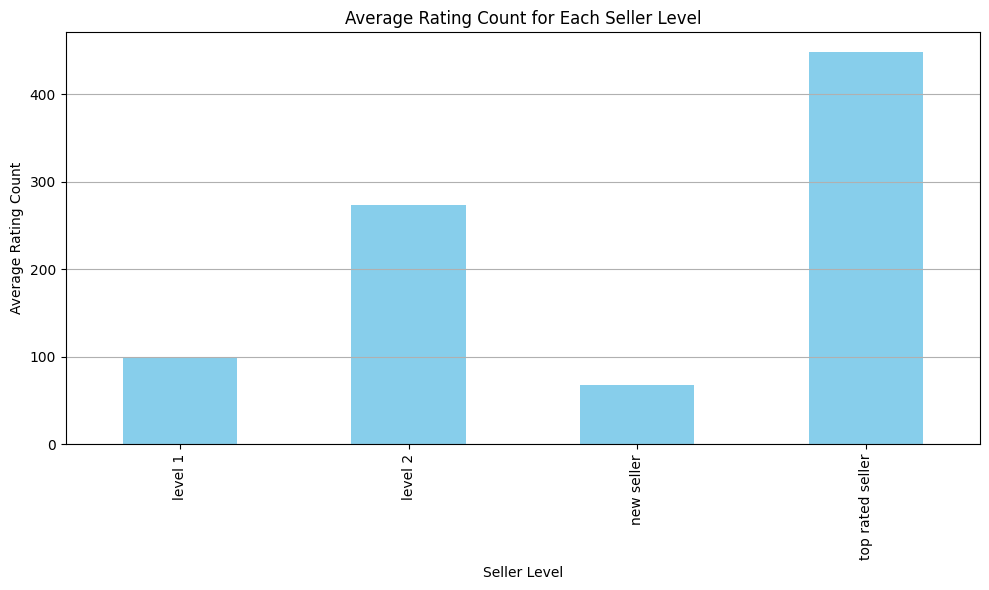

In [131]:
average_counts = df_multi_plan.groupby("Seller Level")["Rating Count"].mean()
plt.figure(figsize=(10, 6))
average_counts.plot(kind="bar", color="skyblue")
plt.xlabel("Seller Level")
plt.ylabel("Average Rating Count")
plt.title("Average Rating Count for Each Seller Level")
plt.grid(axis="y")
plt.tight_layout()
plt.show()

In [65]:
W, p = stats.shapiro(df['Avg Response Time'])
print(f'Shapiro-Wilk test statistic: {W}, p-value: {p}')
W, p = stats.shapiro(df['Rating Count'])
print(f'Shapiro-Wilk test statistic: {W}, p-value: {p}')

Shapiro-Wilk test statistic: nan, p-value: 1.0
Shapiro-Wilk test statistic: 0.3117879033088684, p-value: 0.0


c:\Python311\Lib\site-packages\scipy\stats\_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


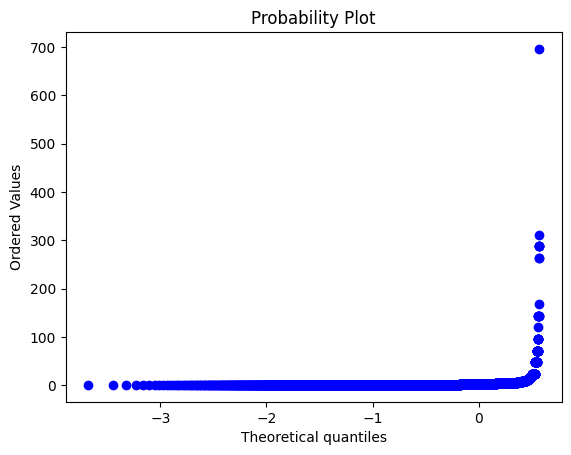

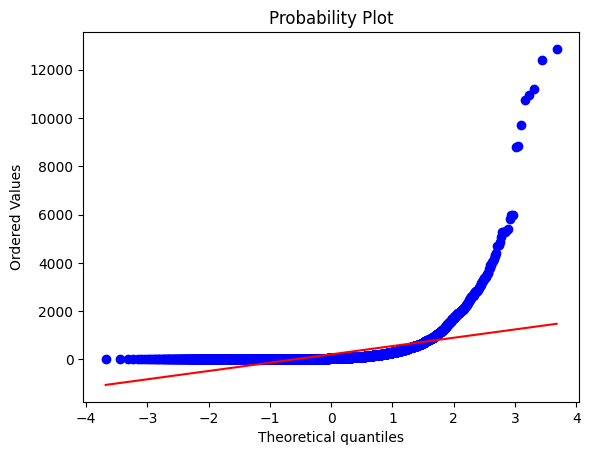

In [66]:
stats.probplot(df['Avg Response Time'], plot=plt)
plt.show()
stats.probplot(df['Rating Count'], plot=plt)
plt.show()

In [67]:
df_copy = df.copy()

df_copy.dropna(subset=['Avg Response Time', 'Rating Count'], inplace=True)

x = df_copy['Avg Response Time']
y = df_copy['Rating Count']

pearson_coef, p_value = stats.pearsonr(x, y)
print("Pearson's correlation coefficient:", pearson_coef)

Pearson's correlation coefficient: -0.03211739739230705


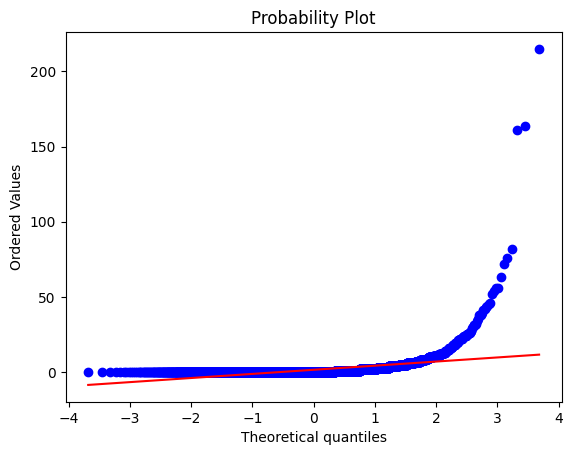

In [68]:
stats.probplot(df['Order in Queue'], plot=plt)
plt.show()

In [69]:
df_copy = df.copy()

df_copy.dropna(subset=['Avg Response Time', 'Order in Queue'], inplace=True)

x = df_copy['Avg Response Time']
y = df_copy['Order in Queue']

spearman_coef, p_value = stats.spearmanr(x, y)
print("Spearman's correlation coefficient:", spearman_coef)

Spearman's correlation coefficient: -0.053936931694605186


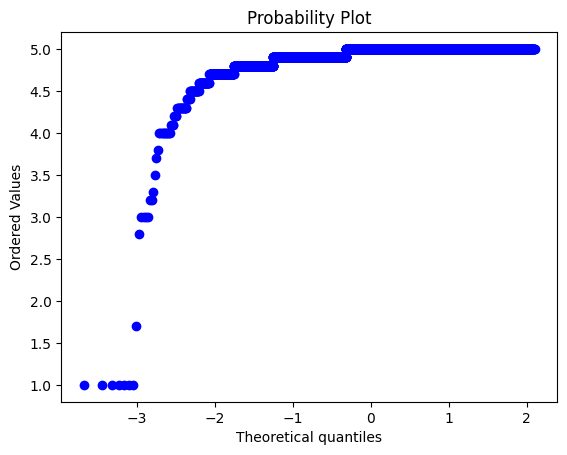

In [70]:
stats.probplot(df['Rating'], plot=plt)
plt.show()

In [71]:
df_copy = df.copy()

df_copy.dropna(subset=['Avg Response Time', 'Rating'], inplace=True)

x = df_copy['Avg Response Time']
y = df_copy['Rating']

spearman_coef, p_value = stats.spearmanr(x, y)
print("Spearman's correlation coefficient:", spearman_coef)

Spearman's correlation coefficient: 0.09825559680015179


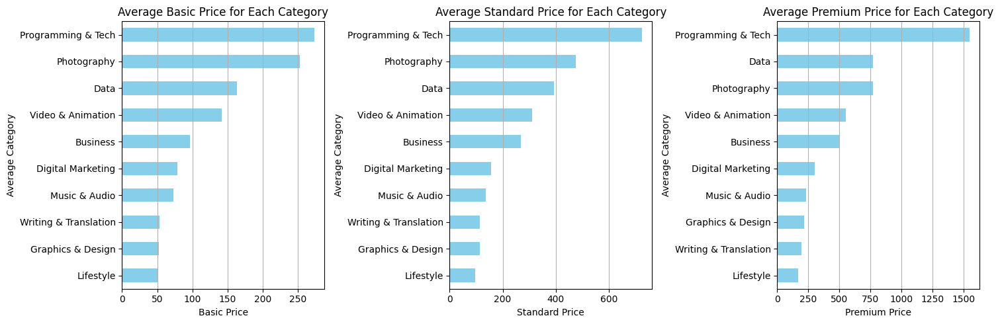

In [73]:
plot_average_prices(df_multi_plan, "Category", ["Basic Price", "Standard Price", "Premium Price"],5)


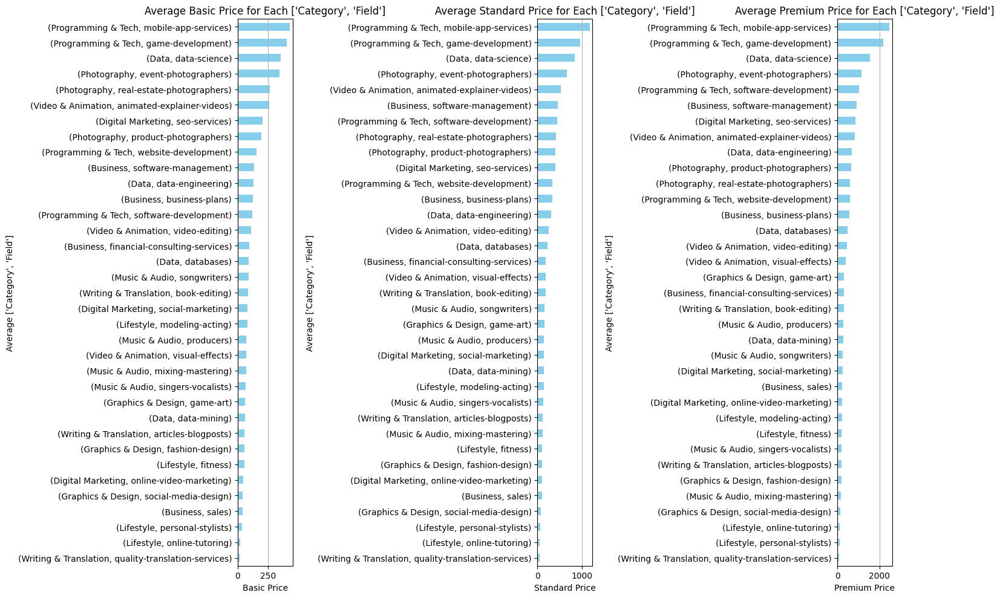

In [74]:
plot_average_prices(df_multi_plan, ["Category","Field"], ["Basic Price", "Standard Price", "Premium Price"],10)

In [75]:
def calculate_outlier_percentage(series):
    q1 = series.quantile(0.25)
    q3 = series.quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers_count = ((series < lower_bound) | (series > upper_bound)).sum()
    total_count = len(series)
    outliers_percentage = (outliers_count / total_count) * 100
    return outliers_percentage

In [76]:
def plot_boxplot(df, x, y):
    plt.figure(figsize=(15, 6))
    sns.boxplot(y=y, x=x, data=df, orient="h")
    plt.title(f"{x} By {y} Box plot")
    plt.ylabel(y)
    plt.xlabel(x)
    plt.show()

    outliers_percentage = df.groupby(y)[x].apply(calculate_outlier_percentage)
    return outliers_percentage

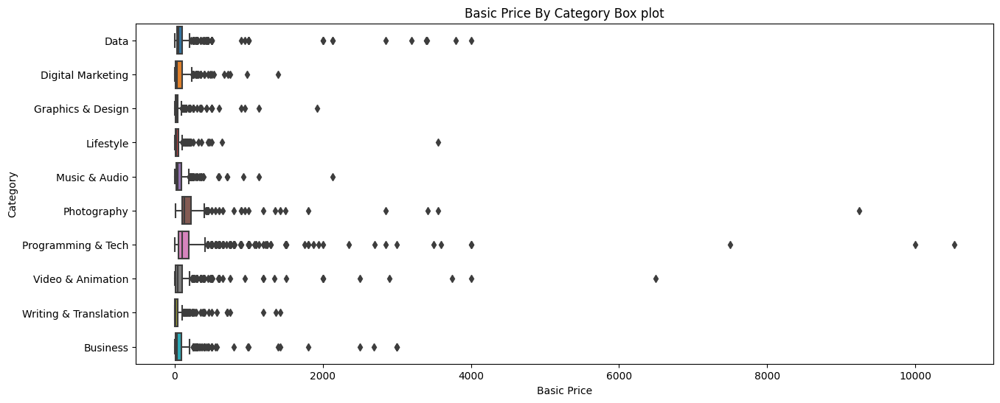

Category
Business                  6.880734
Data                     12.641509
Digital Marketing         7.344633
Graphics & Design        11.485149
Lifestyle                 7.344633
Music & Audio             5.769231
Photography               7.228916
Programming & Tech       13.643178
Video & Animation        11.157025
Writing & Translation     9.883721
Name: Basic Price, dtype: float64


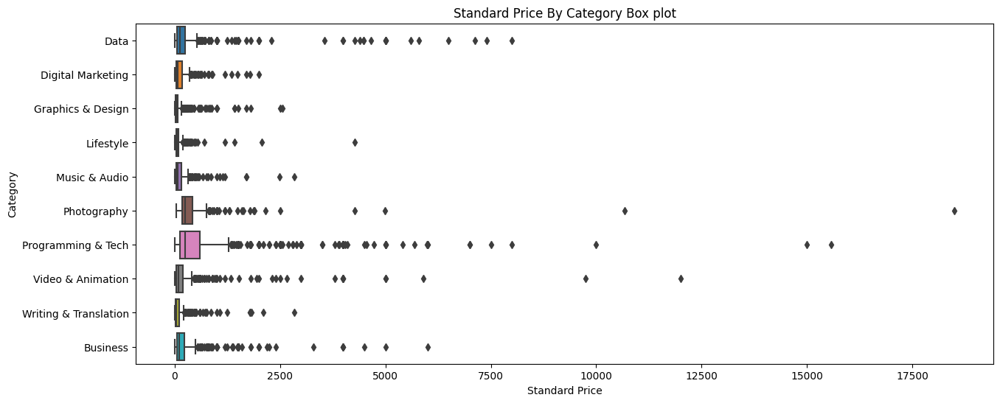

Category
Business                 10.091743
Data                     11.698113
Digital Marketing         8.757062
Graphics & Design        13.861386
Lifestyle                 8.662900
Music & Audio             6.213018
Photography               8.132530
Programming & Tech       13.943028
Video & Animation        11.983471
Writing & Translation    10.465116
Name: Standard Price, dtype: float64


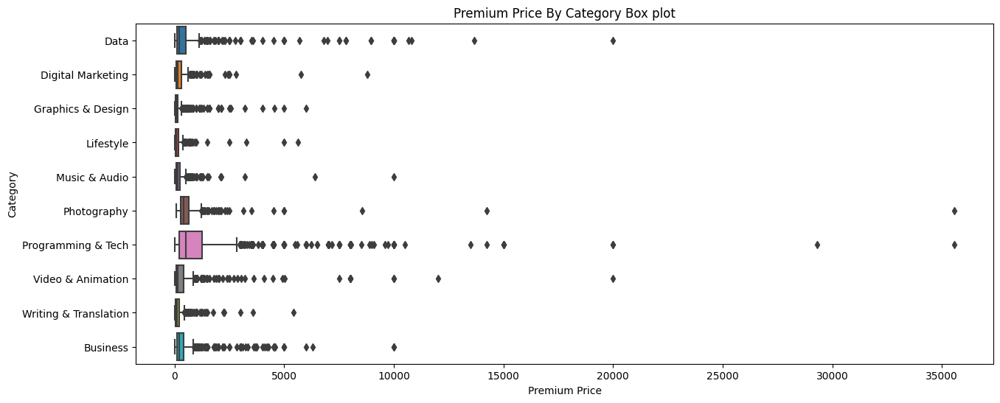

Category
Business                 12.844037
Data                     10.943396
Digital Marketing         7.909605
Graphics & Design        13.267327
Lifestyle                 7.344633
Music & Audio             6.656805
Photography               9.638554
Programming & Tech       15.292354
Video & Animation        11.983471
Writing & Translation     9.302326
Name: Premium Price, dtype: float64


In [77]:
print(plot_boxplot(df_multi_plan,"Basic Price","Category"))
print(plot_boxplot(df_multi_plan,"Standard Price","Category"))
print(plot_boxplot(df_multi_plan,"Premium Price","Category"))

In [87]:
def cat_plot(f1, f2, df, target):
    plt.figure(figsize=(15, 6))
    sns.catplot(x=f1, y=target, hue=f2, data=df, kind="bar", height=6, aspect=2)
    plt.title(f"{target} Distribution by {f1} and {f2}")
    plt.xticks(rotation=45)
    plt.show()

In [79]:
mapping_reverse = {1: "new seller", 2: "level 1", 3: "level 2", 4: "top rated seller"}
df_multi_plan["Seller Level"] = df_multi_plan["Seller Level"].map(mapping_reverse)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_7288\138898060.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_multi_plan["Seller Level"] = df_multi_plan["Seller Level"].map(mapping_reverse)


c:\Python311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x600 with 0 Axes>

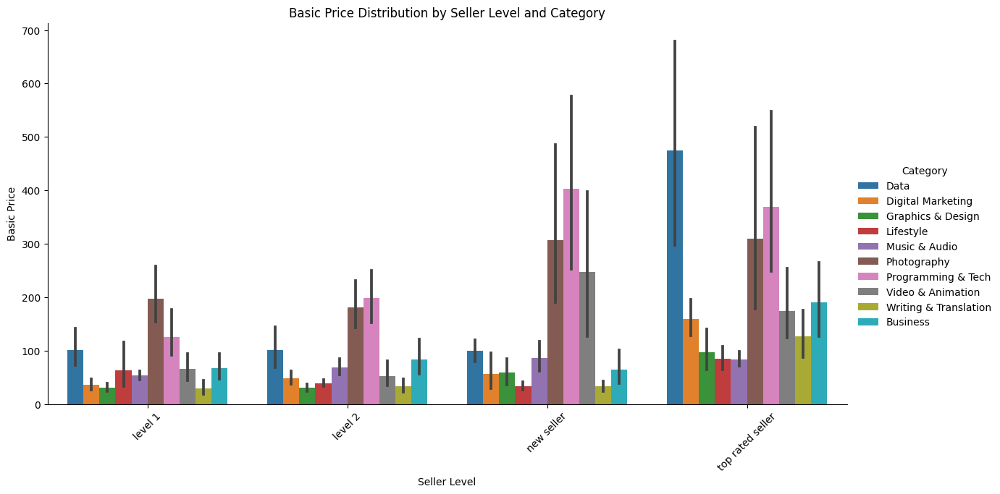

In [88]:
cat_plot('Seller Level', 'Category', df_multi_plan, 'Basic Price')

c:\Python311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x600 with 0 Axes>

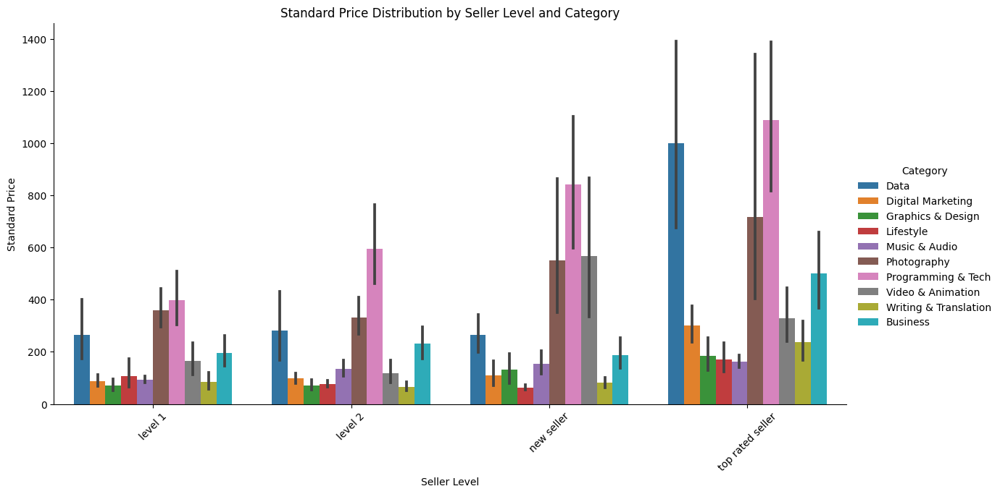

In [91]:
cat_plot("Seller Level", "Category", df_multi_plan, "Standard Price")

c:\Python311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x600 with 0 Axes>

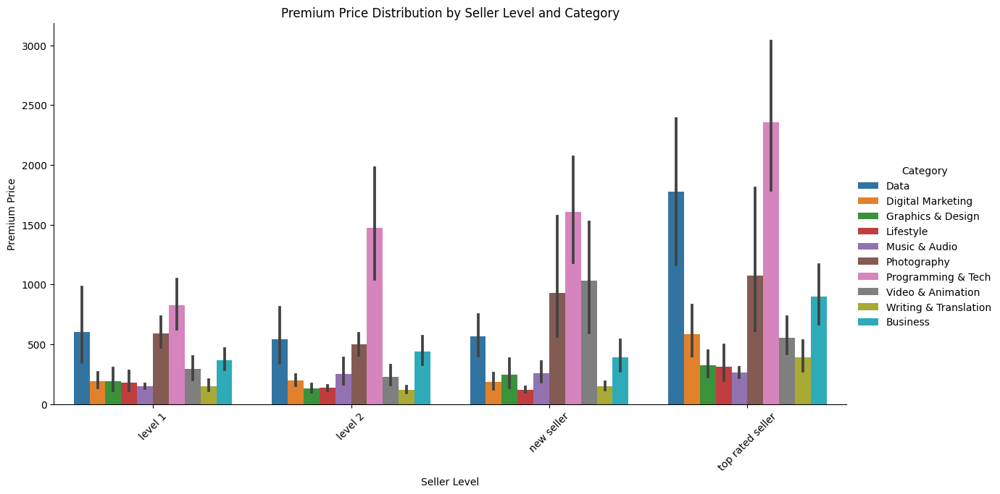

In [92]:
cat_plot("Seller Level", "Category", df_multi_plan, "Premium Price")

In [105]:
import math
def cat_plot_by_category(df, field_col, target_col, plots_per_row=3):
    categories = df["Category"].unique()
    num_categories = len(categories)
    num_rows = math.ceil(num_categories / plots_per_row)

    fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(8 * plots_per_row, 6 * num_rows))
    axes = axes.flatten()

    for i, category in enumerate(categories):
        ax = axes[i]
        cat_df = df[df["Category"] == category]
        sns.barplot(
            x=field_col, y=target_col, hue=field_col, data=cat_df, ax=ax, dodge=False
        )
        ax.set_title(f"{target_col} Distribution for {category} and Field")
        ax.set_ylabel(target_col)
        ax.set_xlabel("")
        ax.set_xticklabels([])
        ax.legend(title=field_col)

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

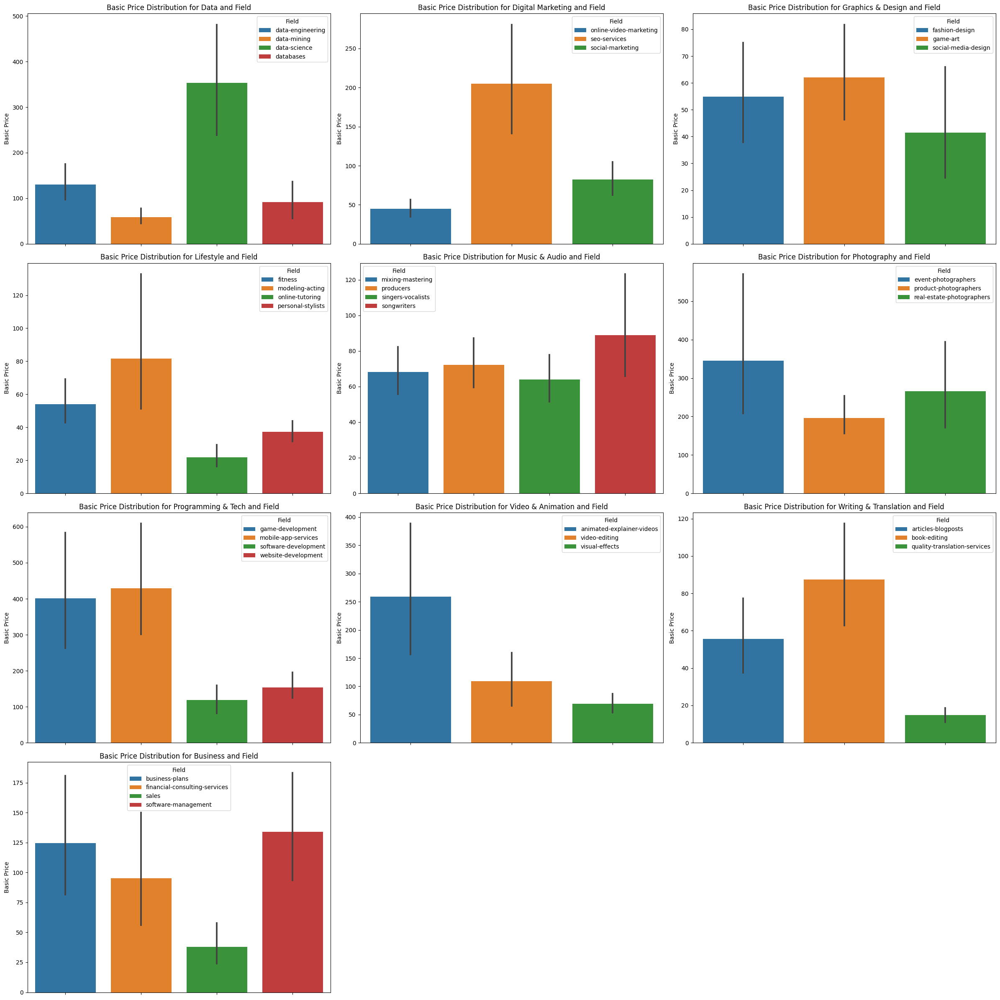

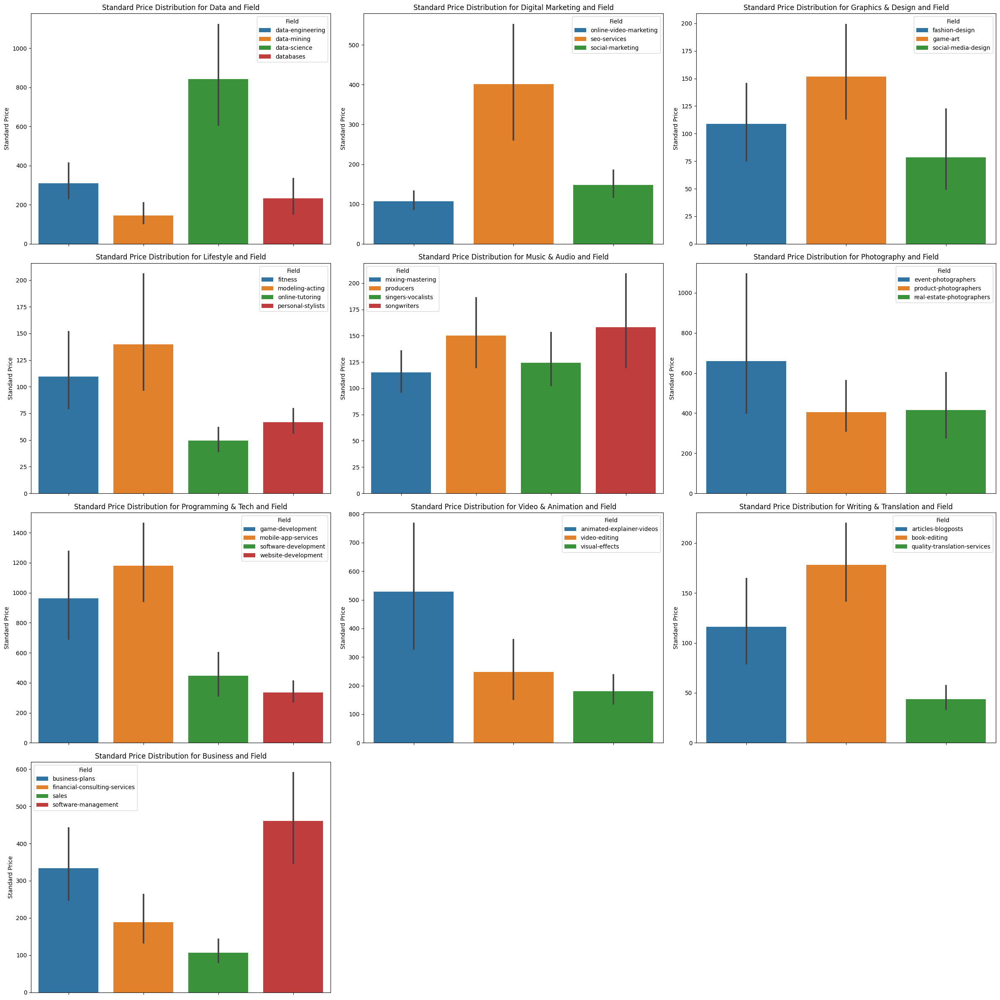

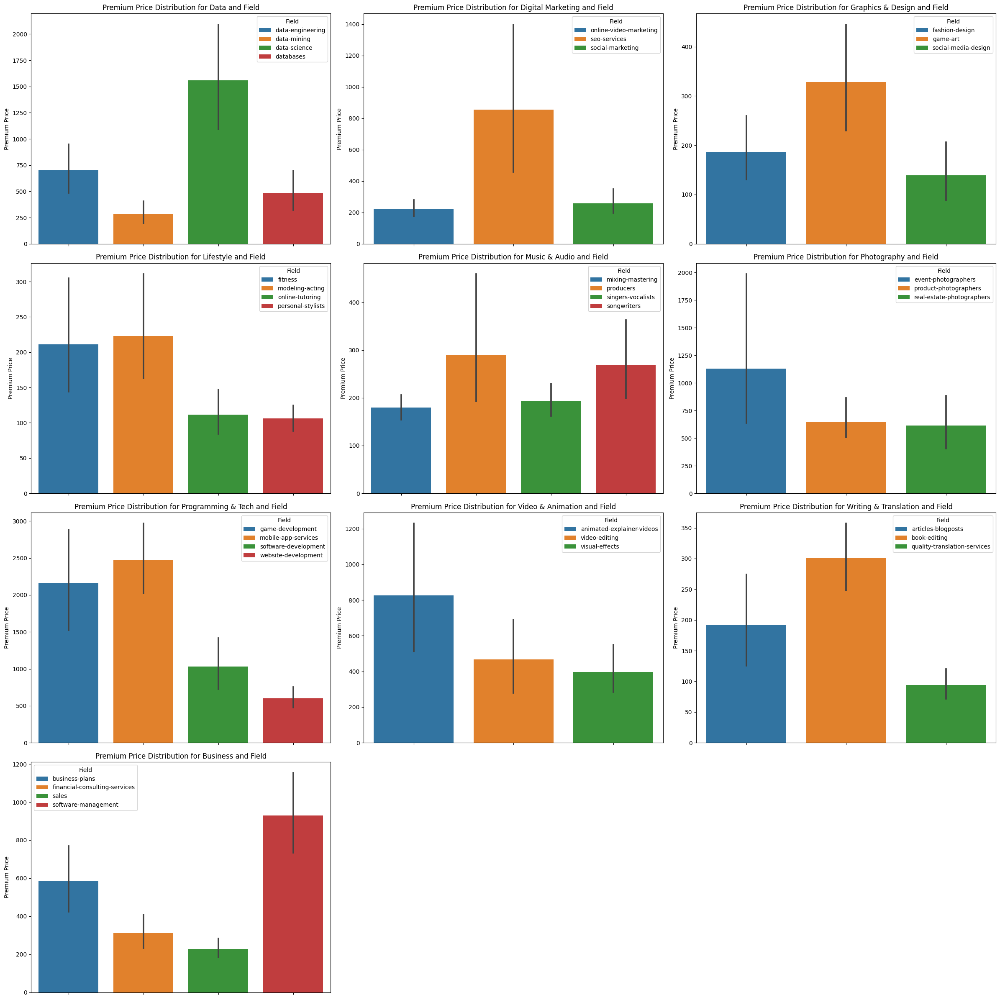

In [106]:
cat_plot_by_category(df_multi_plan, "Field", "Basic Price")
cat_plot_by_category(df_multi_plan, "Field", "Standard Price")
cat_plot_by_category(df_multi_plan, "Field", "Premium Price")